<a href="https://colab.research.google.com/github/RVasconcelosMiguel/ComputerVision/blob/main/VersaodeEntrega.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1> <b>Computer Vision 2024/2025 (1<sup>st</sup> semester) </b> </h1>
<p>Master in Electrical and Computer Engineering </p>

</Body>  


FEUP, 2024



# **Project #01**

# **Identification**

* **Name:** Bernardo de Almeida Soeiro
* **Student Number:** 202008204

* **Name:** Tomás Rosa Carreira
* **Student Number:** 202007783

* **Name:** Rodrigo de Vasconcelos e Miguel
* **Student Number:** 202008406

#Loading and Organizing Image Files for Calibration and Data Processing

In [ ]:
from google.colab import drive
import shutil
import os

# Montar Google Drive
drive.mount('/content/drive')

# Caminho para a pasta no Google Drive onde os arquivos estão
extracted_files_path = '/content/drive/MyDrive/CV_Assignment'

# Copiar a árvore de diretórios da pasta para o diretório atual do Colab
shutil.copytree(extracted_files_path, '/content/CV_Assignment', dirs_exist_ok=True)

print('A pasta CV_Assignment foi copiada para o diretório atual do Colab.')

# Importar a biblioteca Pillow
from PIL import Image

# Caminho para a pasta calib dentro de assign1 no diretório CV_Assignment
calib_path = "/content/CV_Assignment/assign1/calib"
data_path1 = "/content/CV_Assignment/assign1/data/white_isolated"
data_path2 = "/content/CV_Assignment/assign1/data/white_mix"
data_path3 = "/content/CV_Assignment/assign1/data/brown_mix"

# Armazenar todas as imagens PNG da pasta calib em um array
calib_images_array = [os.path.join(calib_path, filename) for filename in os.listdir(calib_path) if filename.endswith('.png')]
data_images_array = [os.path.join(data_path1, filename) for filename in os.listdir(data_path1) if filename.endswith('.png')]
data_images_array_mix= [os.path.join(data_path2, filename) for filename in os.listdir(data_path2) if filename.endswith('.png')]
data_images_array_brown= [os.path.join(data_path3, filename) for filename in os.listdir(data_path3) if filename.endswith('.png')]

# Exibir os caminhos das imagens carregadas
print(f'Imagens carregadas da pasta calib: {calib_images_array}')
print(f'Imagens carregadas da pasta data: {data_images_array}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
A pasta CV_Assignment foi copiada para o diretório atual do Colab.
Imagens carregadas da pasta calib: ['/content/CV_Assignment/assign1/calib/calib_21.png', '/content/CV_Assignment/assign1/calib/calib_8.png', '/content/CV_Assignment/assign1/calib/calib_27.png', '/content/CV_Assignment/assign1/calib/calib_34.png', '/content/CV_Assignment/assign1/calib/calib_26.png', '/content/CV_Assignment/assign1/calib/calib_10.png', '/content/CV_Assignment/assign1/calib/calib_3.png', '/content/CV_Assignment/assign1/calib/calib_15.png', '/content/CV_Assignment/assign1/calib/calib_17.png', '/content/CV_Assignment/assign1/calib/calib_31.png', '/content/CV_Assignment/assign1/calib/calib_32.png', '/content/CV_Assignment/assign1/calib/calib_13.png', '/content/CV_Assignment/assign1/calib/calib_30.png', '/content/CV_Assignment/assign1/calib/calib_20.png', '/content/CV_Assignment/assi

# 1

## Calibration Setup


This code is designed to detect the corresponding corner points of chessboards across multiple images. It uses the real-world 3D points of the chessboard and the detected 2D points in the images to establish correspondences between them. This points will allows to discover the calibration parameters.

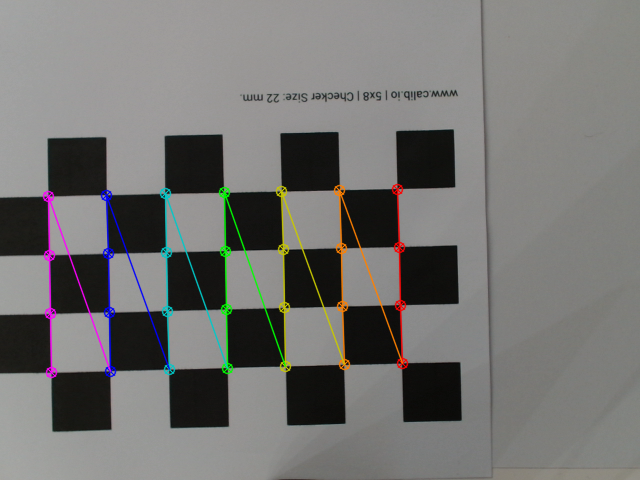

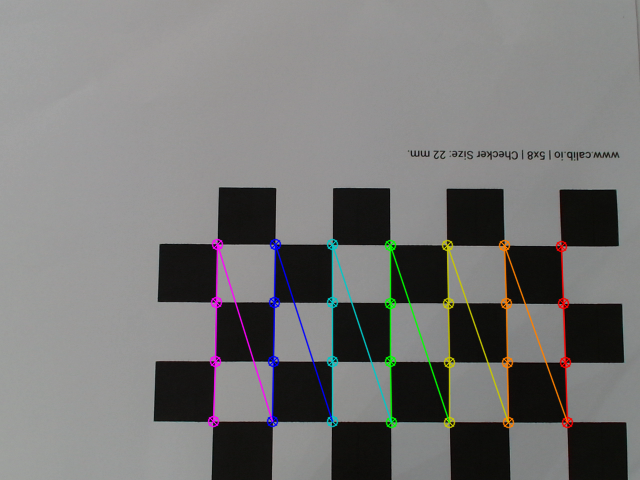

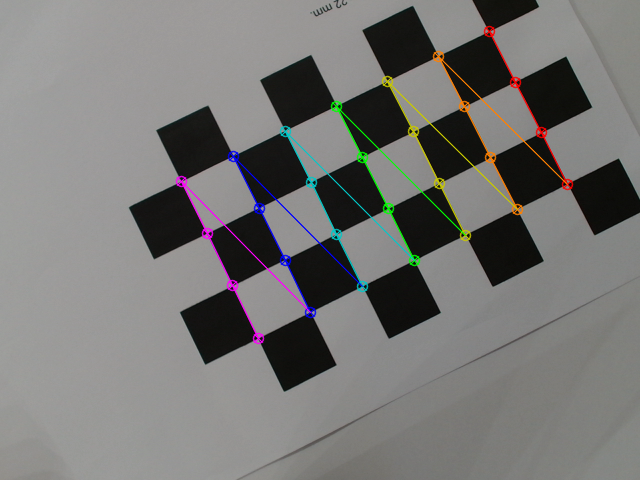

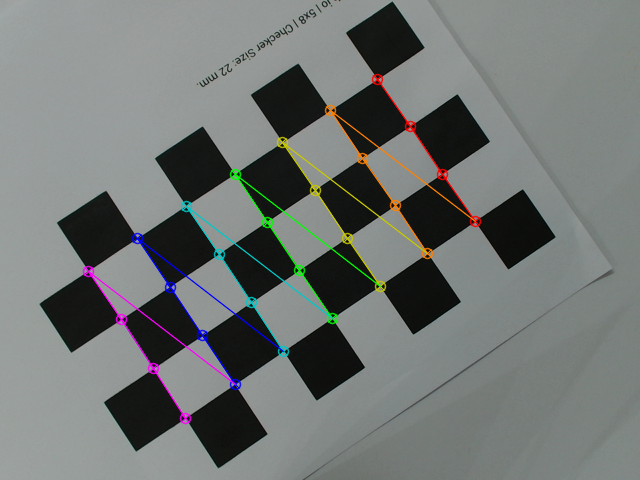

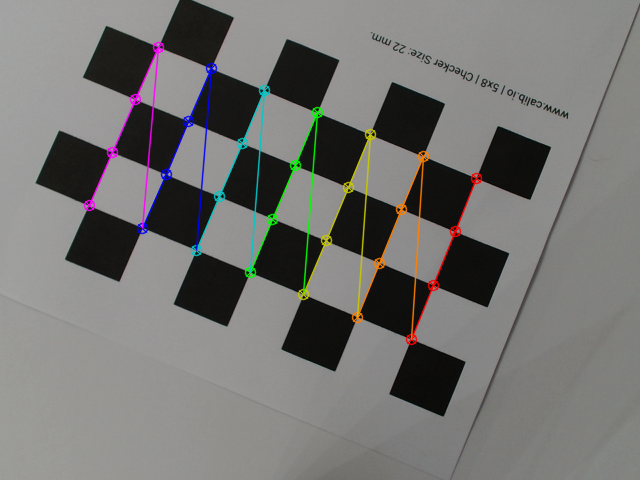

...

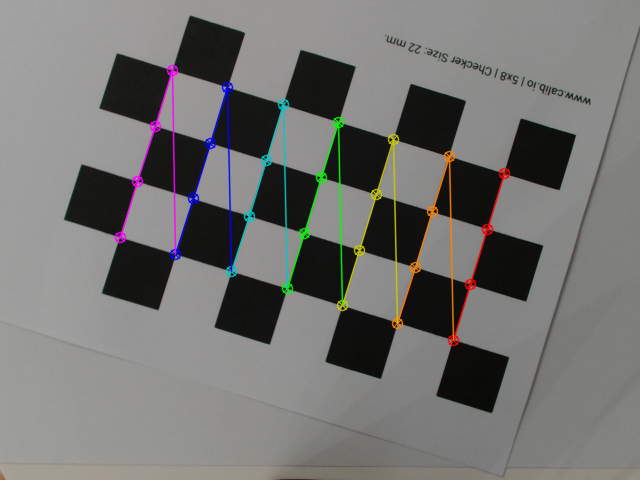

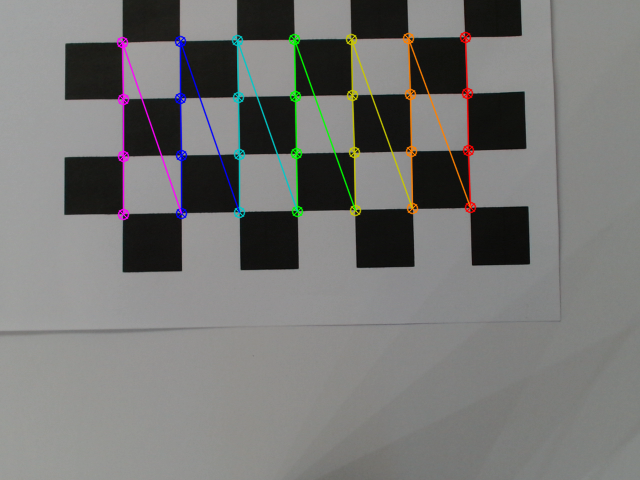

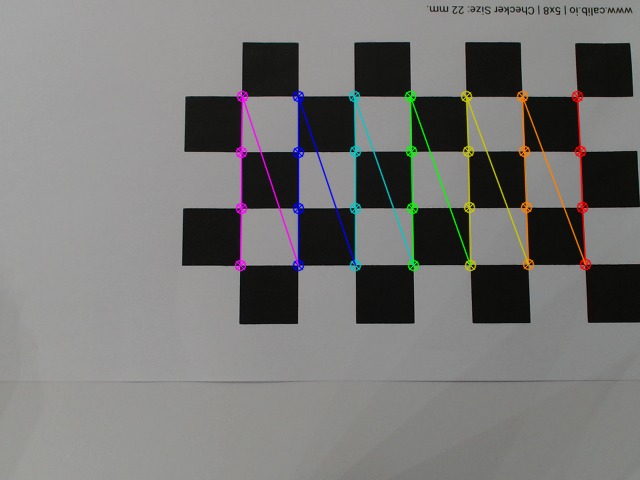

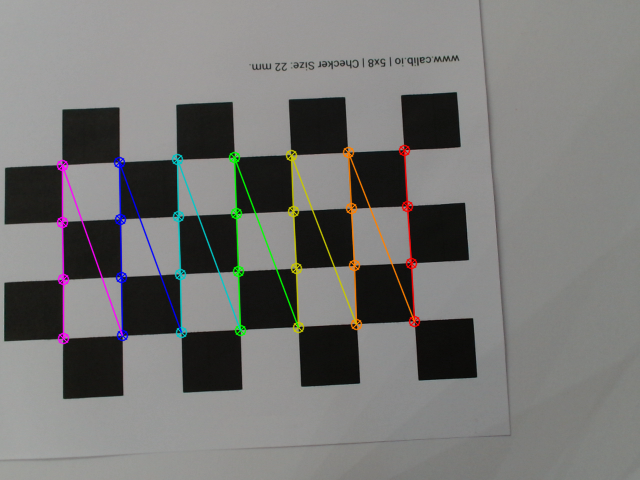

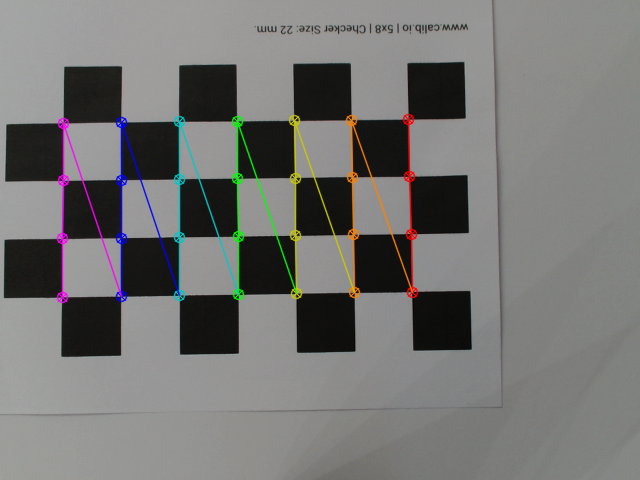

In [ ]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv_imshow

chessboardSize = (4,7)

# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((chessboardSize[0] * chessboardSize[1], 3), np.float32)
objp[:,:2] = np.mgrid[0:chessboardSize[0],0:chessboardSize[1]].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

for fname in calib_images_array:
  img = cv.imread(fname)
  gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

  # Find the chess board corners
  ret, corners = cv.findChessboardCorners(gray, chessboardSize, None)

  # If found, add object points, image points (after refining them)
  if ret == True:
    objpoints.append(objp)

    corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
    imgpoints.append(corners2)

    # Draw and display the corners
    cv.drawChessboardCorners(img, chessboardSize, corners2, ret)
    cv_imshow(img)

## Calibration

Now, by using the detected points and the function **cv.calibrateCamera**, we can obtain the intrinsic matrix, distortion coefficients, rotation vectors, and translation vectors.

In [ ]:
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

print("mtx:\n", mtx)
print("dist:\n", dist)
print("rvecs:\n", rvecs)
print("tvecs:\n", tvecs)

mtx:
 [[449.25750369   0.         334.36046233]
 [  0.         451.38799803 272.36830439]
 [  0.           0.           1.        ]]
dist:
 [[ 2.02429180e-02 -5.20020054e-02  7.31679205e-05 -6.13322533e-04
   2.38577717e-02]]
rvecs:
 (array([[-1.54851839e-02],
       [-1.42839118e-03],
       [ 1.54677076e+00]]), array([[-0.06388669],
       [ 0.05156579],
       [ 1.5746619 ]]), array([[-0.03880443],
       [ 0.01033676],
       [ 1.10957759]]), array([[-0.03545634],
       [ 0.00247981],
       [ 0.97760313]]), array([[-0.03050036],
       [ 0.03054426],
       [ 1.96271702]]), array([[-0.0638974 ],
       [ 0.04620366],
       [ 1.5496001 ]]), array([[-0.03193365],
       [ 0.01880487],
       [ 1.55748058]]), array([[-0.06400543],
       [ 0.04237276],
       [ 1.53321081]]), array([[-1.00078046e-02],
       [ 4.08221313e-04],
       [ 1.56967910e+00]]), array([[-0.0235737 ],
       [-0.03452842],
       [-1.576012  ]]), array([[-0.0324454 ],
       [ 0.02291238],
       [ 1.598444

## Undistortion

This function takes an image as input and uses the calibration parameters that we obtained to produce a rectified and undistored version, enhancing quality of the visual data.

In [ ]:
def undistort_image(image):
    img = cv.imread(image)
    h, w = img.shape[:2]
    newcameramtx, roi = cv.getOptimalNewCameraMatrix(mtx, dist, (w, h), 1, (w, h))

    #Aply undistortion
    dst = cv.undistort(img, mtx, dist, None, newcameramtx)

    #crop image
    x, y, w, h = roi
    dst = dst[y:y+h, x:x+w]

    return dst

In [ ]:
mean_error = 0
for i in range(len(objpoints)):
    imgpoints2, _ = cv.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    error = cv.norm(imgpoints[i], imgpoints2, cv.NORM_L2)/len(imgpoints2)
    mean_error += error

print( "total error: {}".format(mean_error/len(objpoints)) )

total error: 0.03674798048630936


#2


## Blob Detection



Here we convert the image to a gray scale to highlight the black parts of an ruler, then we aplly a blob detector to identify the position of the numbers on the ruler

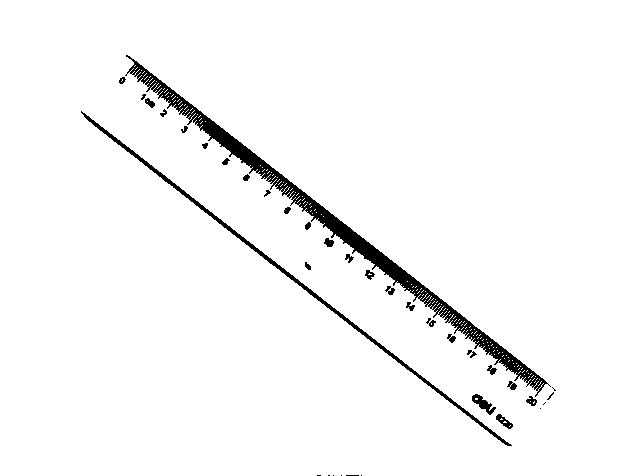

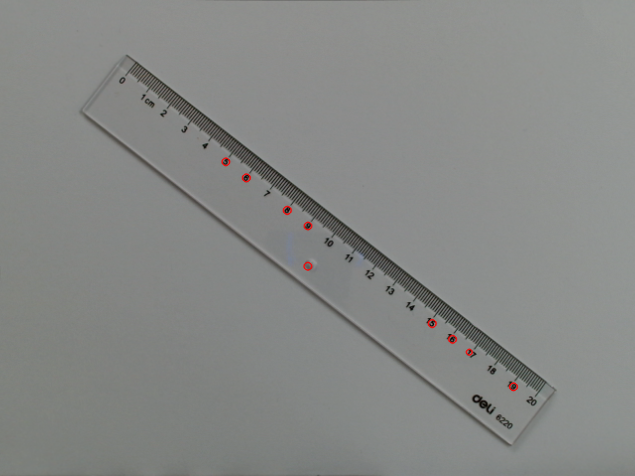

In [ ]:
# Undistort ruler image
ruler_img = undistort_image('/content/CV_Assignment/assign1/data/ruler.png')

# Grayscale
gray = cv.cvtColor(ruler_img, cv.COLOR_BGR2GRAY)

# Thresholding
_, binary_image = cv.threshold(gray, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)
cv_imshow(binary_image)

# Blob detector
params = cv.SimpleBlobDetector_Params()
params.filterByArea = True
params.minArea = 10
params.maxArea = 100
params.filterByColor = True
params.blobColor = 0

detector = cv.SimpleBlobDetector_create(params)
keypoints = detector.detect(binary_image)

image_with_blobs = ruler_img.copy()
image_with_blobs = cv.drawKeypoints(image_with_blobs, keypoints, outImage=image_with_blobs, color=(0, 0, 255), flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv_imshow(image_with_blobs)

##Outlier Removel

While highlighting the keypoints we have an outlier that we needed to remove, we used a linear regression-based approach to filter them by their distance from the regression line.

In [ ]:
from sklearn.linear_model import LinearRegression
#function that removes outlier keypoints based on their distance from the linear regression line
def remove_outliers(keypoints, threshold):
  x = np.array([keypoint.pt[0] for keypoint in keypoints])
  y = np.array([keypoint.pt[1] for keypoint in keypoints])

  regression = LinearRegression()
  regression.fit(x.reshape(-1, 1), y)

  predicted_y = regression.predict(x.reshape(-1, 1))
  distances = np.abs(y - predicted_y)

  filtered_keypoints = [keypoint for keypoint, distance in zip(keypoints, distances) if distance <= threshold]

  return filtered_keypoints

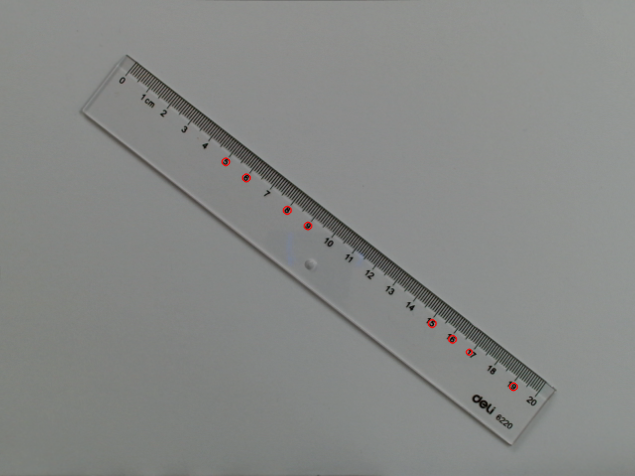

In [ ]:
# Show Keypoints on the image
image_with_filtered_keypoints = ruler_img.copy()
filtered_keypoints = remove_outliers(keypoints, 20)

image_with_filtered_keypoints = cv.drawKeypoints(image_with_filtered_keypoints, filtered_keypoints, outImage=image_with_filtered_keypoints, color=(0, 0, 255), flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv_imshow(image_with_filtered_keypoints)

In [ ]:
for keypoint in filtered_keypoints:
  print("(x, y) = (" + str(keypoint.pt[0]) + ", " + str(keypoint.pt[1]) + ")")

(x, y) = (513.0232543945312, 386.3178405761719)
(x, y) = (468.840576171875, 351.6666564941406)
(x, y) = (452.0823059082031, 338.8312683105469)
(x, y) = (431.7736511230469, 323.0576171875)
(x, y) = (307.5, 225.5)
(x, y) = (286.7854309082031, 209.900390625)
(x, y) = (245.88095092773438, 177.36111450195312)
(x, y) = (225.34901428222656, 161.31764221191406)


##Conersion from Pixels to Millimeters

In this code, we assign the physical measurements in millimeters to the respective keypoints in an array. For each pair of distinct keypoints, we calculate the norm (Euclidean distance) between them in both pixels and millimeters. Using these distances, we compute the conversion rate between pixels and millimeters. These rates are stored in a list, and after iterating over all keypoint pairs, we determine the median conversion rate.

point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (468.840576171875, 351.6666564941406)  
distance in mm = 20 | distance in pixel = 56.14992086560407
rate = 2.8074960432802034
point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (452.0823059082031, 338.8312683105469)  
distance in mm = 30 | distance in pixel = 77.2578393947936
rate = 2.575261313159787
point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (431.7736511230469, 323.0576171875)  
distance in mm = 40 | distance in pixel = 102.97258807545954
rate = 2.5743147018864887
point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (307.5, 225.5)  
distance in mm = 100 | distance in pixel = 260.963955259155
rate = 2.60963955259155
point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (286.7854309082031, 209.900390625)  
distance in mm = 110 | distance in pixel = 286.8913895938761
rate = 2.6081035417625102
point1 (x, y) = (513.0232543945312

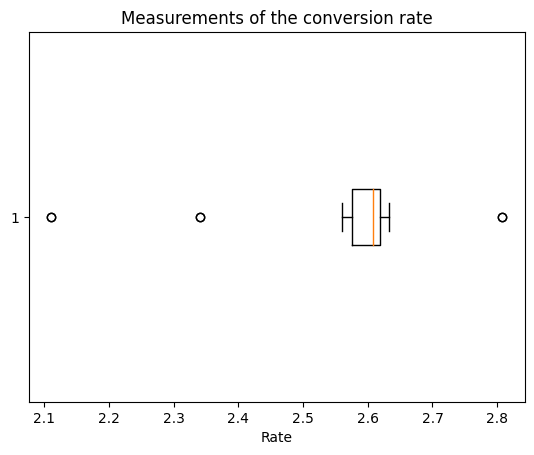

In [ ]:

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pylab as plt


point_to_mm = { # the lower the key the lower the y coordinate in pixel and the associated value is the respective ruler mark measure in mm
  0: 190,
  1: 170,
  2: 160,
  3: 150,
  4: 90,
  5: 80,
  6: 60,
  7: 50,
}

rates=[]

for i in range(len(filtered_keypoints)):
  for j in range(len(filtered_keypoints)):
    if(i != j):

      print("point1 (x, y) = (" + str(filtered_keypoints[i].pt[0]) + ", " + str(filtered_keypoints[i].pt[1]) + ")  " )
      print("point2 (x, y) = (" + str(filtered_keypoints[j].pt[0]) + ", " + str(filtered_keypoints[j].pt[1]) + ")  " )

      point1 = (filtered_keypoints[i].pt[0], filtered_keypoints[i].pt[1])
      point2 = (filtered_keypoints[j].pt[0], filtered_keypoints[j].pt[1])

      distance_in_mm = np.abs(point_to_mm.get(i) - point_to_mm.get(j))
      distance_in_pixel = cv.norm(point1, point2)
      rate = distance_in_pixel / distance_in_mm
      rates.append(rate)

      print("distance in mm = " + str(distance_in_mm) + " | distance in pixel = " + str(distance_in_pixel))
      print("rate = " + str(rate))

print("")

Conversion_rate = np.median(rates)
print("Median rate: " + str(Conversion_rate))


 # Plotting
plt.boxplot(rates, vert=False)
plt.title("Measurements of the conversion rate")
plt.xlabel('Rate');

#3

## M&M Sorting


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import pandas as pd
from google.colab.patches import cv2_imshow # for image display since cv2.imshow crashes the Colab
from skimage import io
from PIL import Image
import matplotlib.pylab as plt
import time

This code processes images to identify and highlight M&M's. It involves several steps, including undistorting and filtering the images to reduce noise, converting them to different color spaces (HSV and grayscale), and adjusting brightness and contrast to enhance object visibility. A thresholding method creates a binary mask to separate the objects from the background. After cleaning the mask, the contours of the objects are identified, and the regions of interest (ROIs) are displayed with rectangles around the detected M&M's.

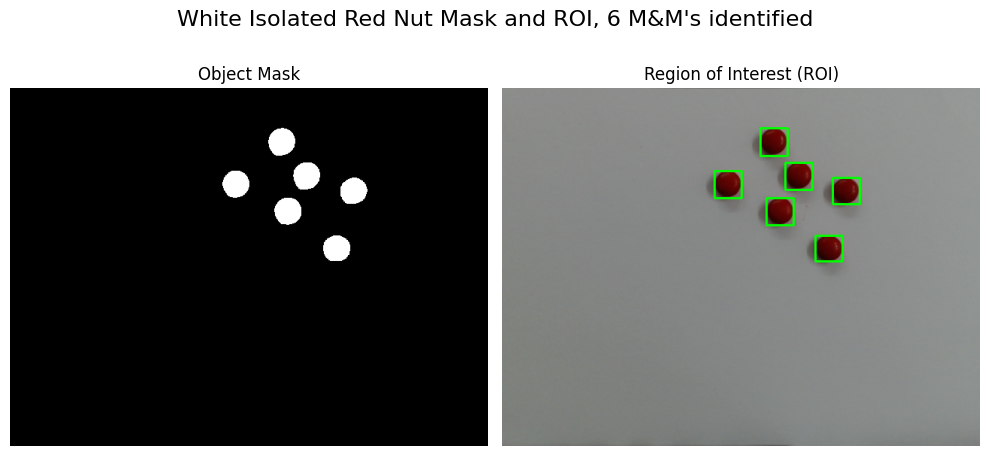

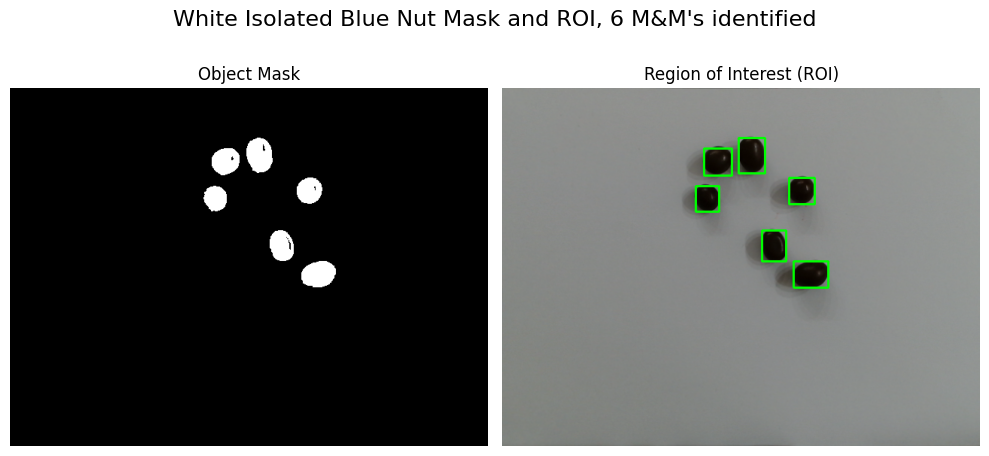

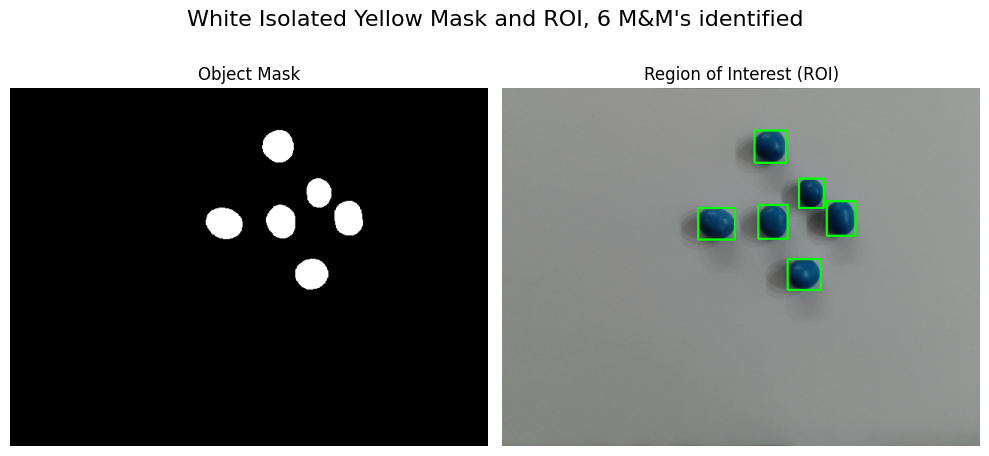

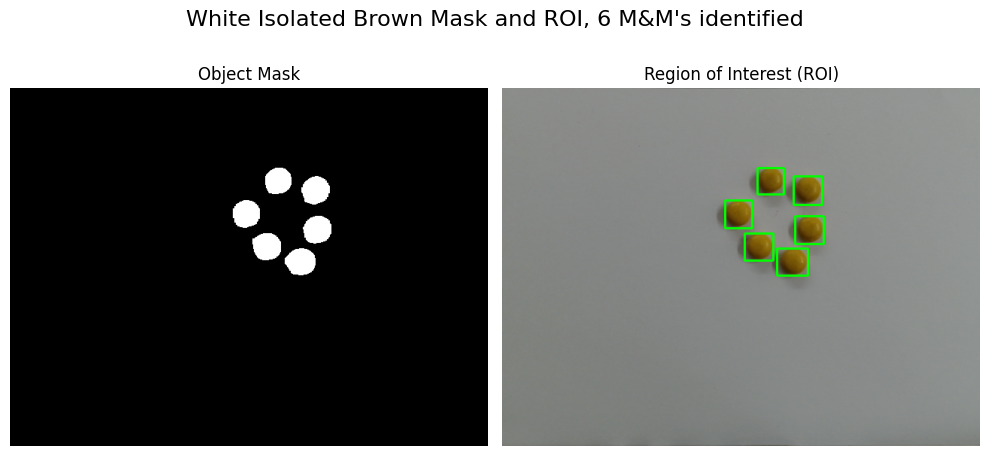

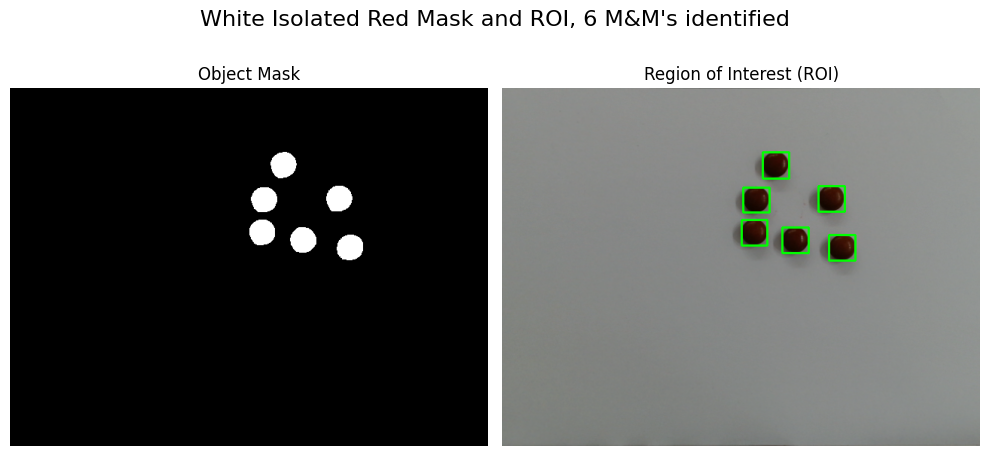

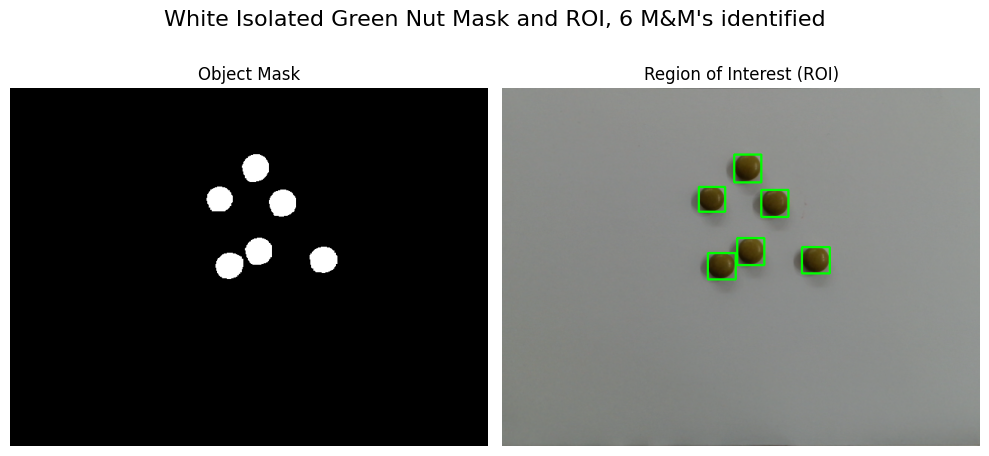

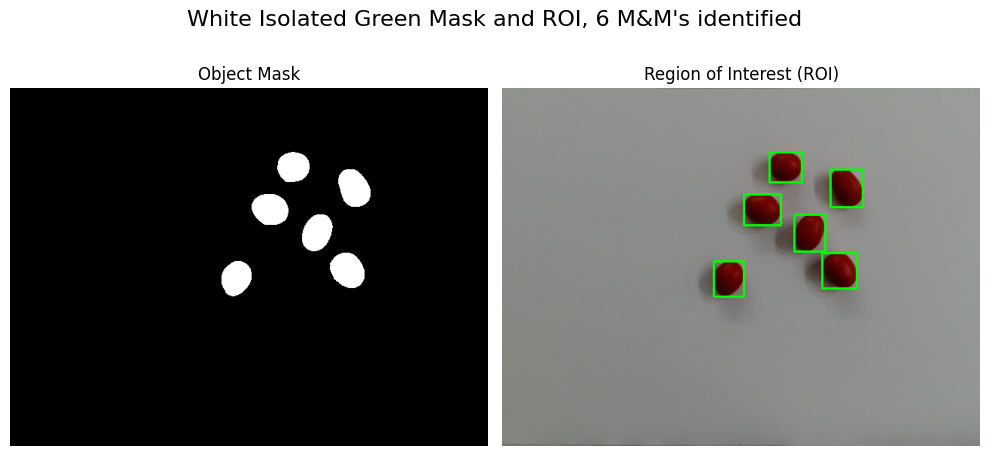

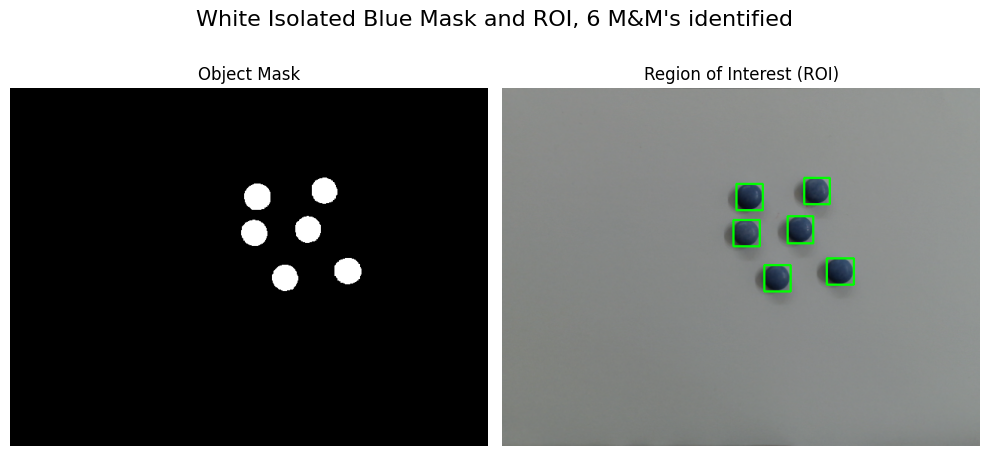

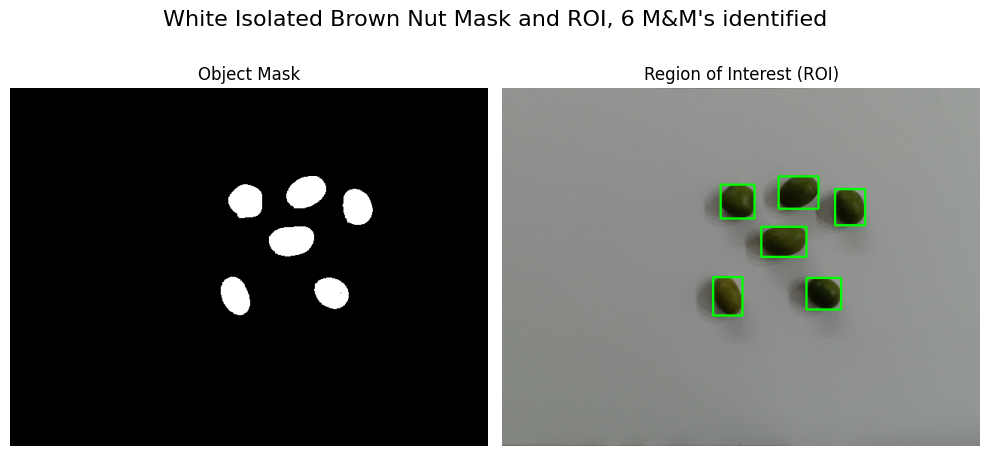

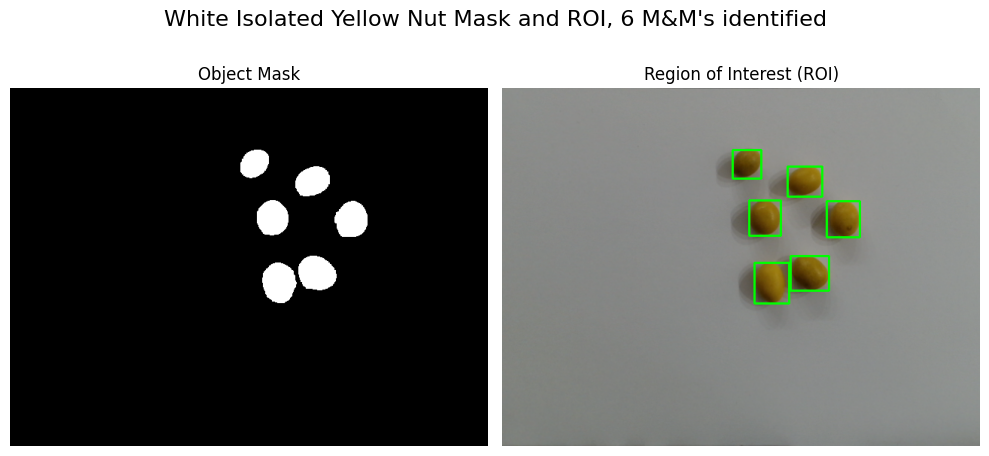

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow  # Para exibição de imagens no Colab
import time

# As imagens já estão no vetor `data_images_array`
images_desc = ["Red Nut", "Blue Nut", "Yellow", "Brown", "Red", "Green Nut", "Green", "Blue", "Brown Nut", "Yellow Nut"]

# Loop para processar as imagens
for image, image_desc in zip(data_images_array, images_desc):


  image_ori=undistort_image(image)

  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)

  image_hsv = cv2.cvtColor(image_ori, cv2.COLOR_RGB2HSV)

  v = 255
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], v)

  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

  non_white_pixels = image_gray[image_gray <= 255]

  if non_white_pixels.size > 0:
    sorted_pixels = np.sort(non_white_pixels)
    lowest_100_pixels = sorted_pixels[:10000] if sorted_pixels.size >= 10000 else sorted_pixels
    average_value = np.mean(lowest_100_pixels)

  image_gray = cv2.add(image_gray, np.full(image_gray.shape, (255-average_value)/2, dtype=np.uint8))

  threshold=254
  max_value=255

  background_mask = cv2.threshold(image_gray, threshold, max_value, cv2.THRESH_BINARY)[1]

  object_mask = cv2.bitwise_not(background_mask)

  kernel_3 = np.ones((3, 3), np.uint8)

  object_mask_clean = cv2.erode(object_mask, kernel_3, iterations=1)
  object_mask_clean = cv2.dilate(object_mask_clean, kernel_3, iterations=1)

  result = cv2.bitwise_and(image, image, mask=object_mask_clean)

  contours,_=cv2.findContours(object_mask_clean , cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

  true_contours = 0;

  # Consider only contours with area higher than 20
  for c in contours:
    if (cv2.contourArea(c) < 200):
      continue
    x,y,w,h = cv2.boundingRect(c)
    ROI=cv2.rectangle(image_ori,(x,y),(x+w,y+h),(0,255,0),2)
    true_contours += 1

  #show image with centroid
  fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

  # Display the first image
  axes[0].imshow(object_mask_clean, cmap='gray')
  axes[0].set_title("Object Mask")
  axes[0].axis('off')  # Turn off axis

  # Display the second image
  ROI = cv2.cvtColor(ROI, cv2.COLOR_BGR2RGB)
  axes[1].imshow(ROI)
  axes[1].set_title("Region of Interest (ROI)")
  axes[1].axis('off')  # Turn off axis

  # Show the plot
  plt.suptitle("White Isolated " + str(image_desc) + " Mask and ROI, " + str(true_contours) + " M&M's identified", fontsize=16)
  plt.tight_layout()
  plt.show()
  print("\n\n")


##3b

Here we start by converting the image to HSV scale and we calculate the histogram for each channel and are displayed side by side providing a clear comparison of the color distributions in each image. These histograms shows us the color compositions in each of the M&M's images

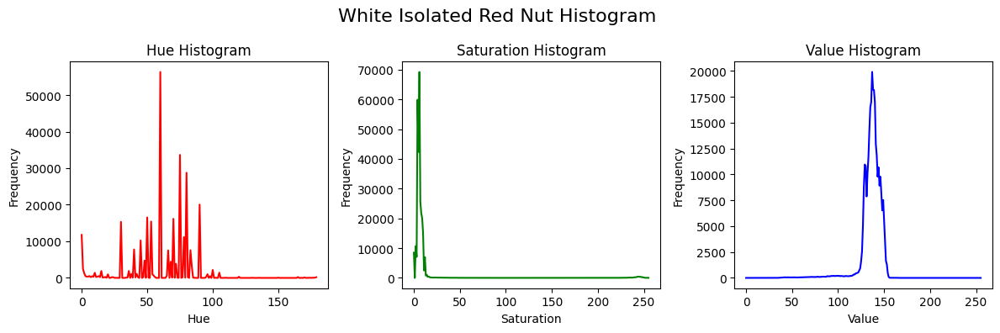

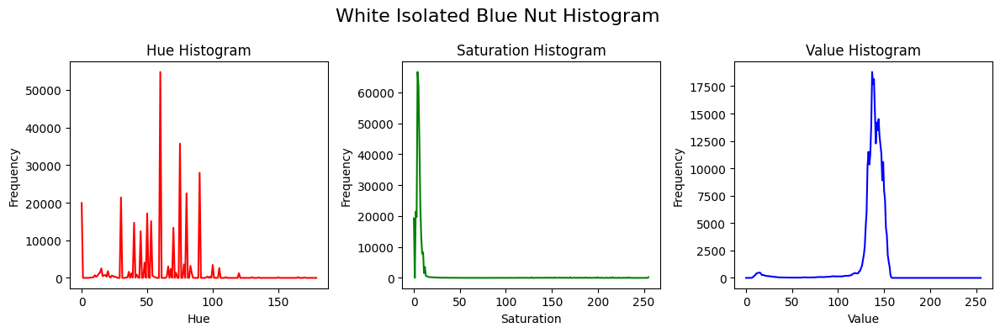

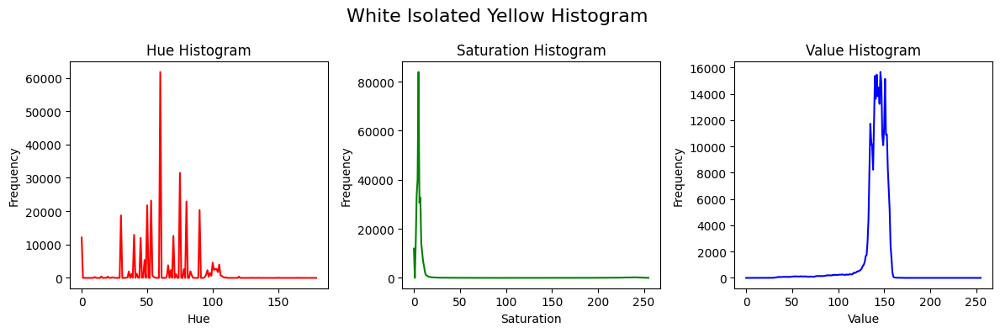

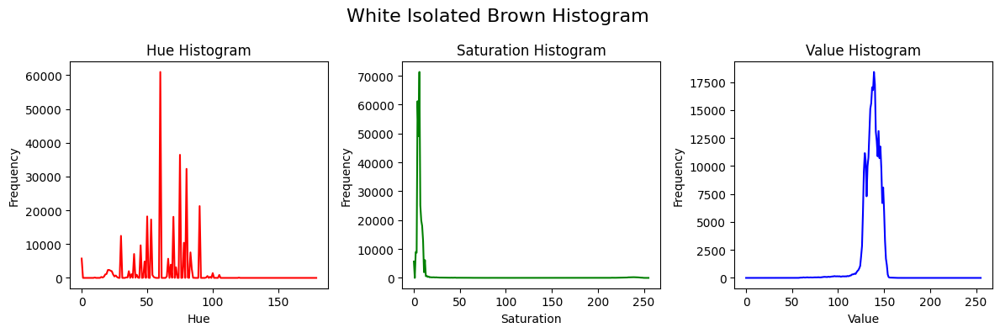

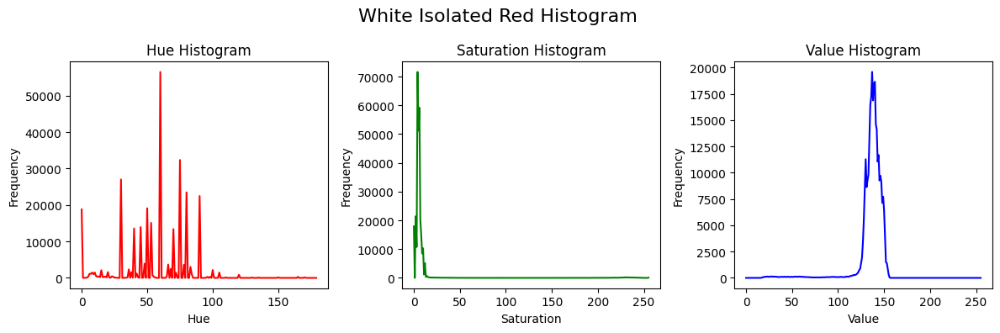

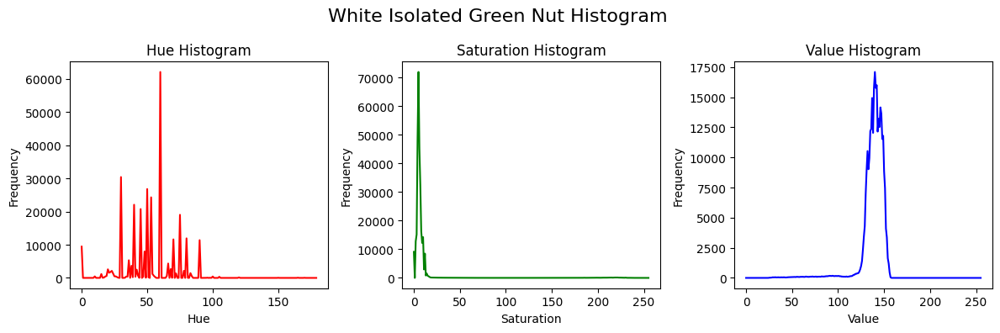

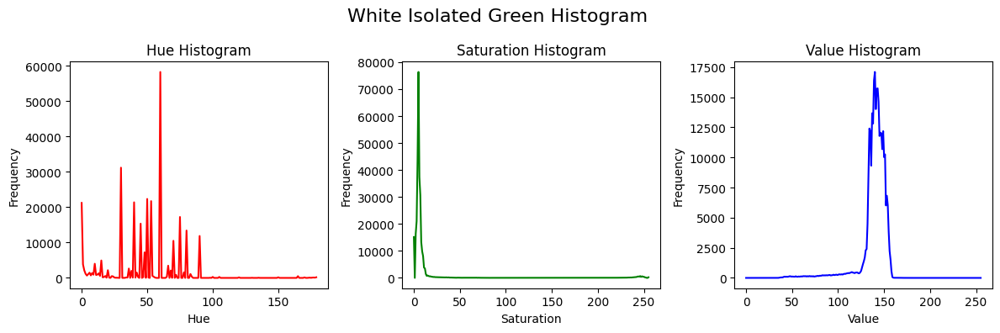

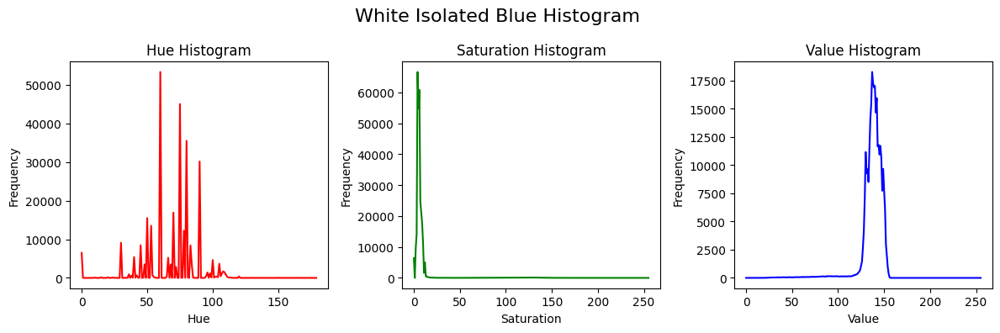

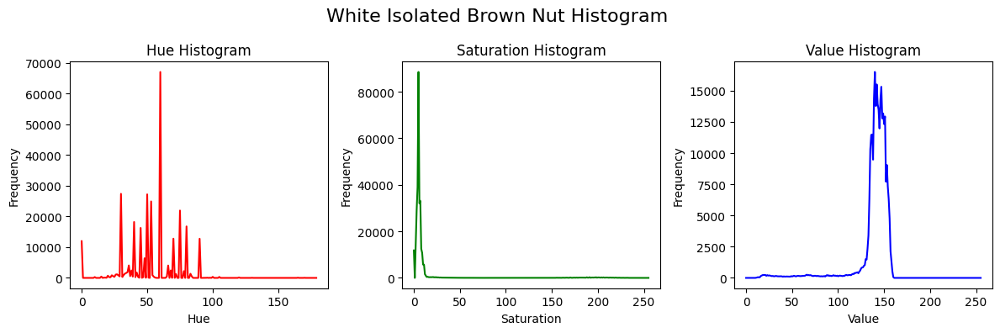

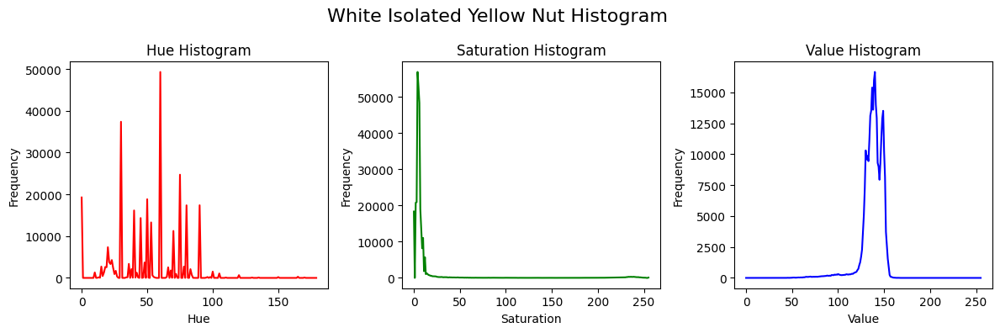

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import pandas as pd
from google.colab.patches import cv2_imshow # for image display since cv2.imshow crashes the Colab
from skimage import io
from PIL import Image
import matplotlib.pylab as plt
import time

images_desc = ["Red Nut", "Blue Nut", "Yellow", "Brown", "Red", "Green Nut", "Green", "Blue", "Brown Nut", "Yellow Nut"]

for image, image_desc in zip(data_images_array, images_desc):

  # Convert the image to HSV
  hsv_img = cv2.cvtColor(undistort_image(image), cv2.COLOR_BGR2HSV)

  # Calculate the histogram for each channel
  hist_h = cv2.calcHist([hsv_img], [0], None, [180], [0, 180])
  hist_s = cv2.calcHist([hsv_img], [1], None, [256], [0, 256])
  hist_v = cv2.calcHist([hsv_img], [2], None, [256], [0, 256])

  # Display the histograms
  plt.figure(figsize=(12, 4))

  plt.subplot(1, 3, 1)
  plt.plot(hist_h, color='r')
  plt.title('Hue Histogram')
  plt.xlabel('Hue')
  plt.ylabel('Frequency')

  plt.subplot(1, 3, 2)
  plt.plot(hist_s, color='g')
  plt.title('Saturation Histogram')
  plt.xlabel('Saturation')
  plt.ylabel('Frequency')

  plt.subplot(1, 3, 3)
  plt.plot(hist_v, color='b')
  plt.title('Value Histogram')
  plt.xlabel('Value')
  plt.ylabel('Frequency')

  plt.suptitle("White Isolated " + str(image_desc) + " Histogram ", fontsize=16)
  plt.tight_layout()
  plt.show()
  print("\n\n")


## 3-c)

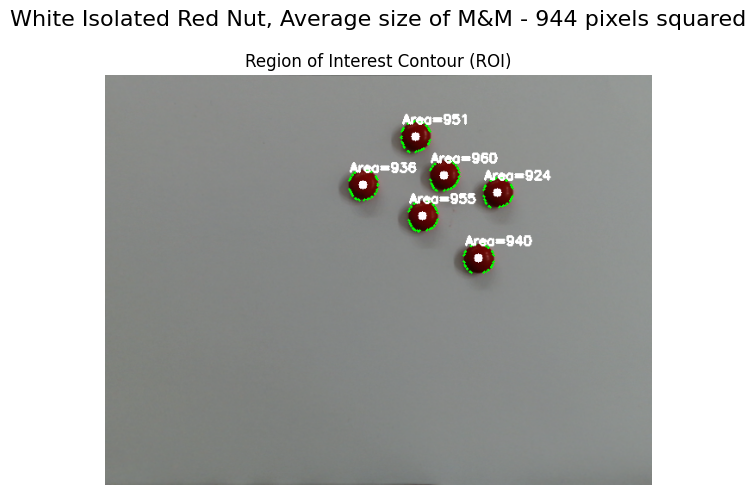

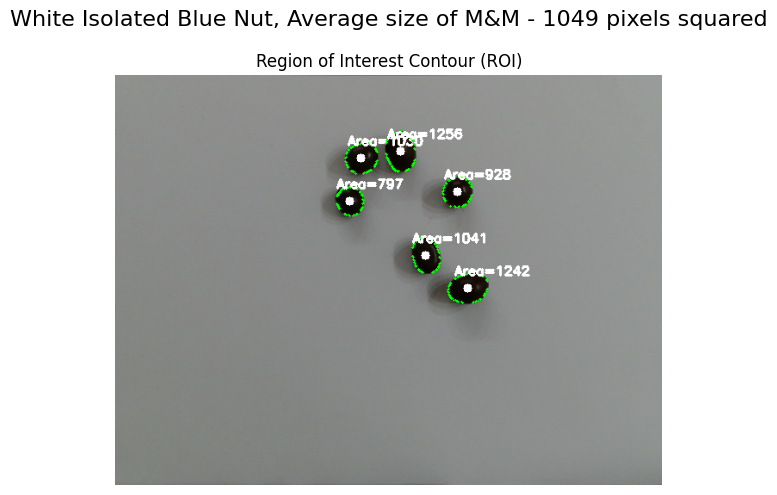

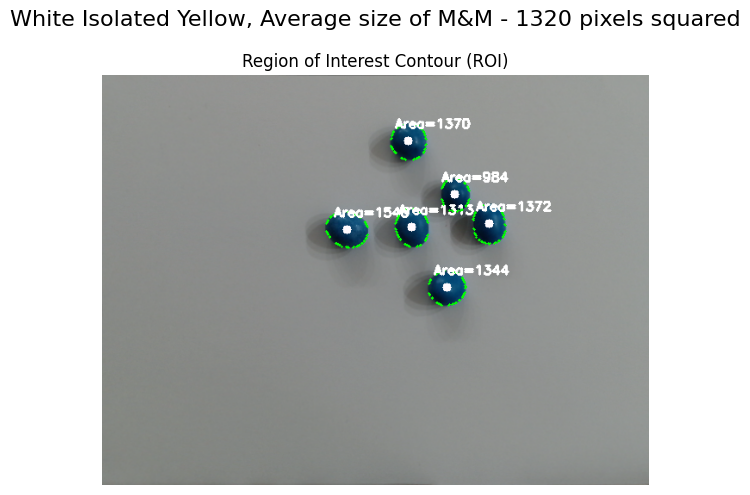

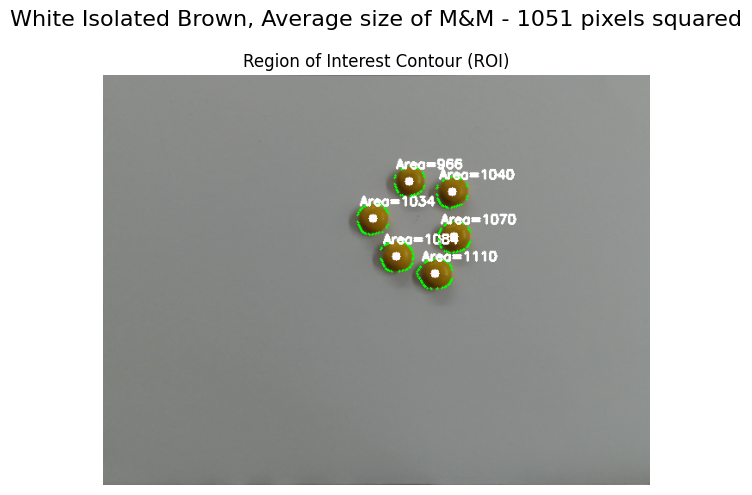

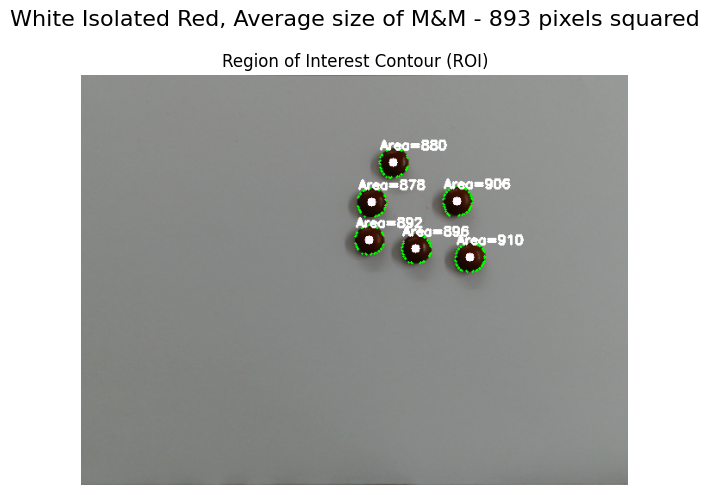

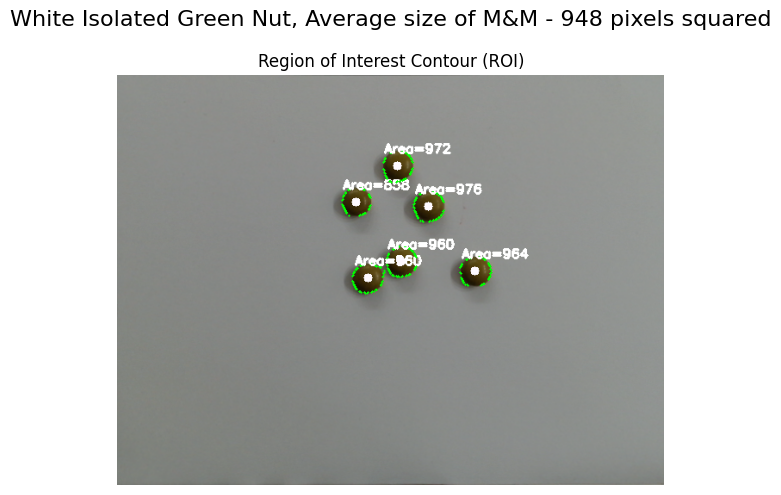

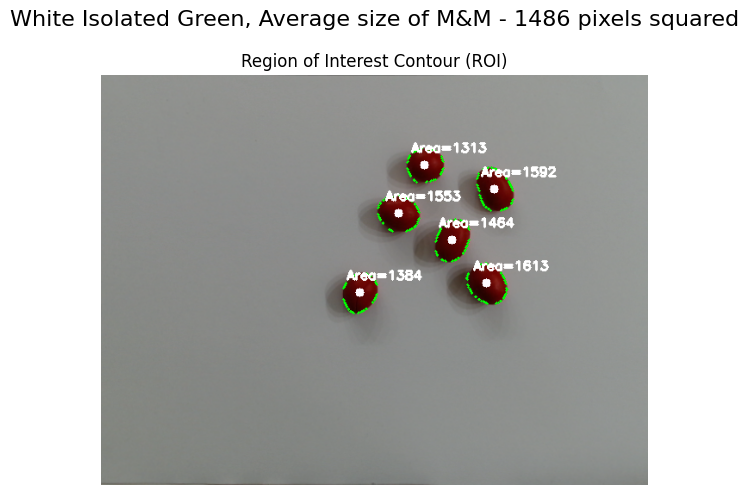

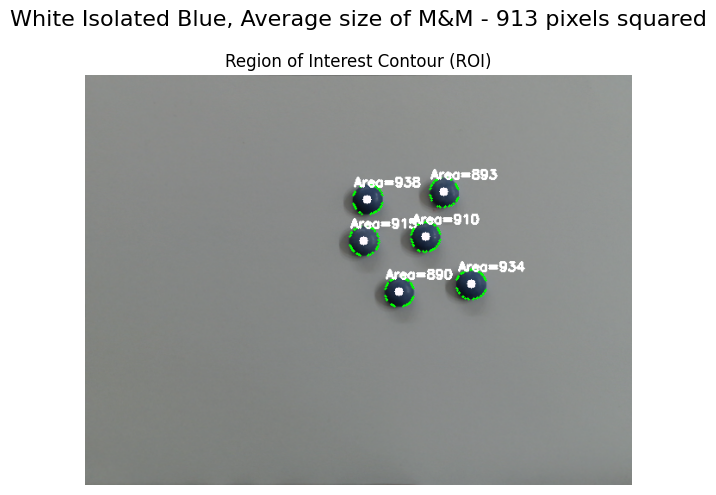

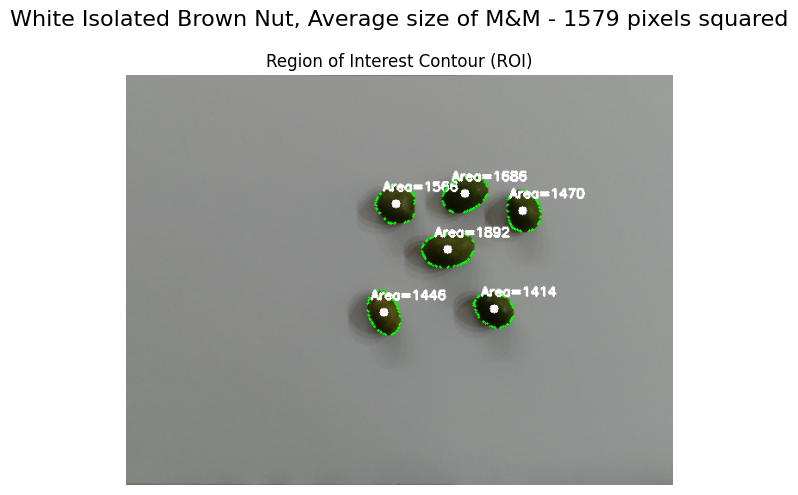

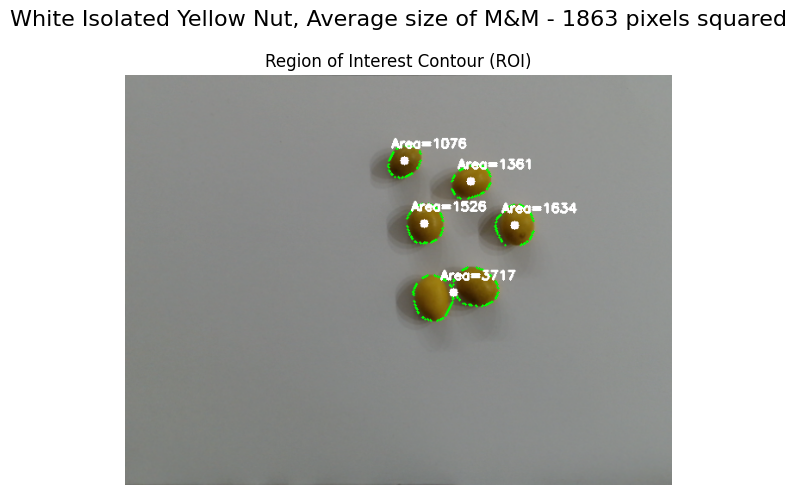




Average size of the contours: 1194


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

sizes = []
images_desc = ["Red Nut", "Blue Nut", "Yellow", "Brown", "Red", "Green Nut", "Green", "Blue", "Brown Nut", "Yellow Nut"]

for image, image_desc in zip(data_images_array, images_desc):


    image_ori=undistort_image(image)



    image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)

    image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)

    v = 255
    image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], v)

    image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
    image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

    non_white_pixels = image_gray[image_gray <= 255]

    if non_white_pixels.size > 0:
      sorted_pixels = np.sort(non_white_pixels)
      lowest_100_pixels = sorted_pixels[:10000] if sorted_pixels.size >= 10000 else sorted_pixels
      average_value = np.mean(lowest_100_pixels)

    image_gray = cv2.add(image_gray, np.full(image_gray.shape, (255-average_value)/2, dtype=np.uint8))

    threshold=254
    max_value=255

    background_mask = cv2.threshold(image_gray, threshold, max_value, cv2.THRESH_BINARY)[1]

    object_mask = cv2.bitwise_not(background_mask)

    kernel_3 = np.ones((3, 3), np.uint8)

    object_mask_clean = cv2.erode(object_mask, kernel_3, iterations=1)
    object_mask_clean = cv2.dilate(object_mask_clean, kernel_3, iterations=1)

    contours,_=cv2.findContours(object_mask , cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    true_contours = 0

    # Consider only contours with area higher than 20

    average_size = []
    average_size.clear()
    for c in contours:
      if (cv2.contourArea(c) < 50):
        continue
      sizes.append(cv2.contourArea(c))
      average_size.append(cv2.contourArea(c))
      #print("Size of the contours:", cv2.contourArea(c))

      ROI_c = cv2.drawContours(image_ori, c, -1, (0, 255, 0), 2)
      M = cv2.moments(c)

      if M["m00"] != 0:
        cX = int(M["m10"] / M["m00"])
        cY = int(M["m01"] / M["m00"])
      else:
        cX, cY = 0, 0

      # Draw the centroid of the largest contour on the image
      cv2.circle(ROI_c, (cX, cY), 5, (255, 250, 255), -1)
      cv2.putText(ROI_c, "Area=" + str(round(cv2.contourArea(c))), (cX - 15, cY - 15), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
      true_contours += 1
      # Create a figure and axes
    fig, axes = plt.subplots(1, 1, figsize=(10, 5))  # 1 row, 1 column

    # Display the second image (ROI_c)
    ROI_c = cv2.cvtColor(ROI_c, cv2.COLOR_BGR2RGB)
    axes.imshow(ROI_c)
    axes.set_title("Region of Interest Contour (ROI)")
    axes.axis('off')  # Turn off axis

    # Add a main title for the entire figure using dynamic content
    plt.suptitle("White Isolated " + str(image_desc) + ", Average size of M&M - " + str(round(np.mean(average_size))) + " pixels squared", fontsize=16)

    # Show the plot
    plt.tight_layout()
    plt.subplots_adjust(top=0.85)  # Adjust the top to fit the title
    plt.show()
    print("\n\n")

average_size = np.mean(sizes)
print("Average size of the contours:", round(average_size))

## 3-d)































Red Nut Image

Red Nut - Average Size: 2463.1885962510814
Standard Deviation for Red Nut: 32.12015573013254


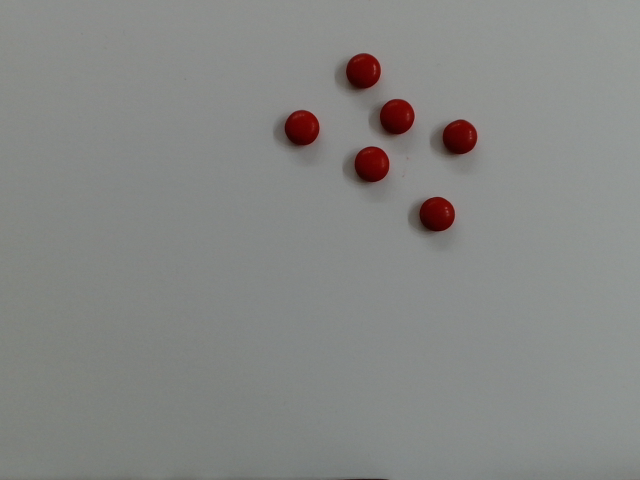


---------------------------------------------------------------------------------------

Blue Nut Image

Blue Nut - Average Size: 2736.199969079475
Standard Deviation for Blue Nut: 424.19079232392676


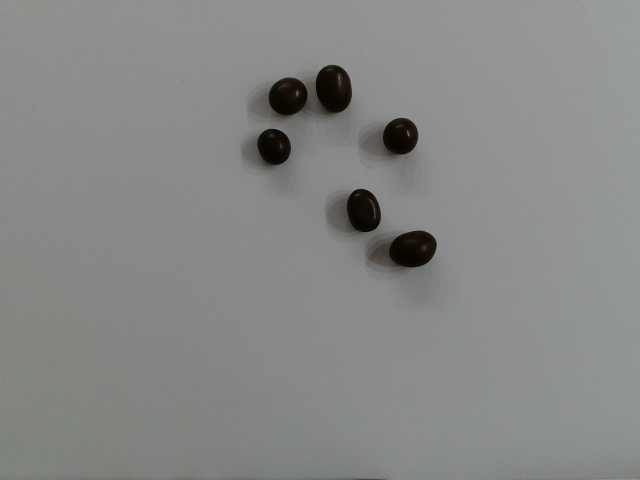


---------------------------------------------------------------------------------------

Yellow Image

Yellow - Average Size: 3443.9428273034
Standard Deviation for Yellow: 434.94097549653935


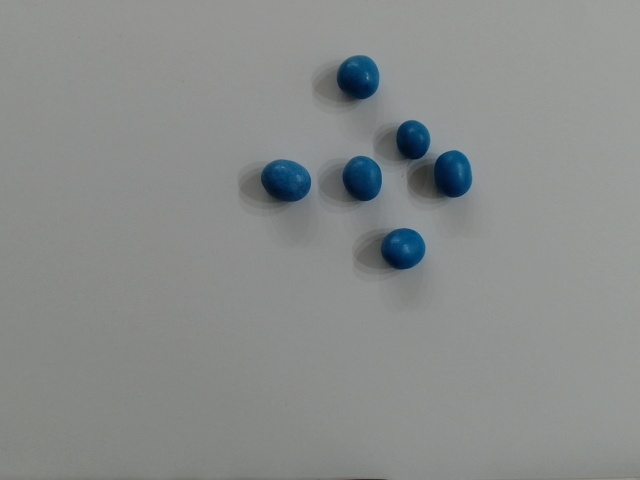


---------------------------------------------------------------------------------------

Brown Image

Brown - Average Size: 2740.5472839334307
Standard Deviation for Brown: 119.81723422910669


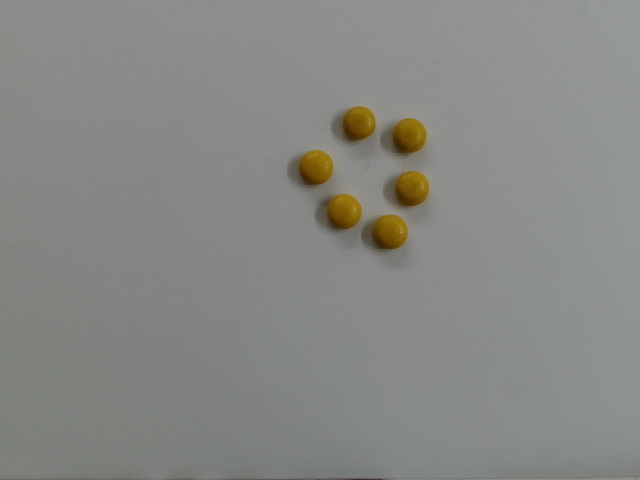


---------------------------------------------------------------------------------------

Red Image

Red - Average Size: 2330.3781274627463
Standard Deviation for Red: 31.131904491687987


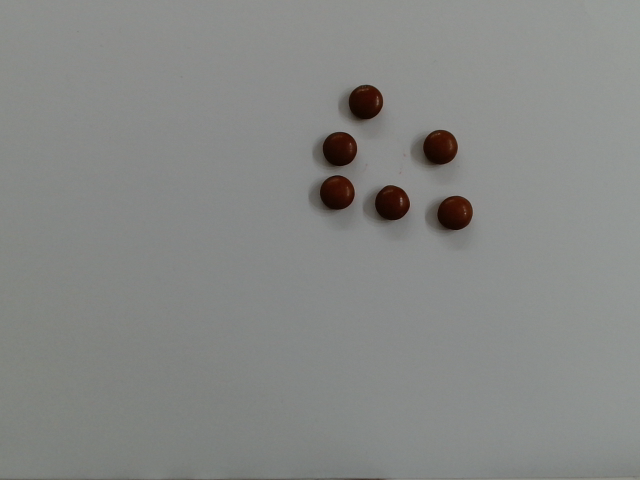


---------------------------------------------------------------------------------------

Green Nut Image

Green Nut - Average Size: 2473.622151900574
Standard Deviation for Green Nut: 105.92293082815631


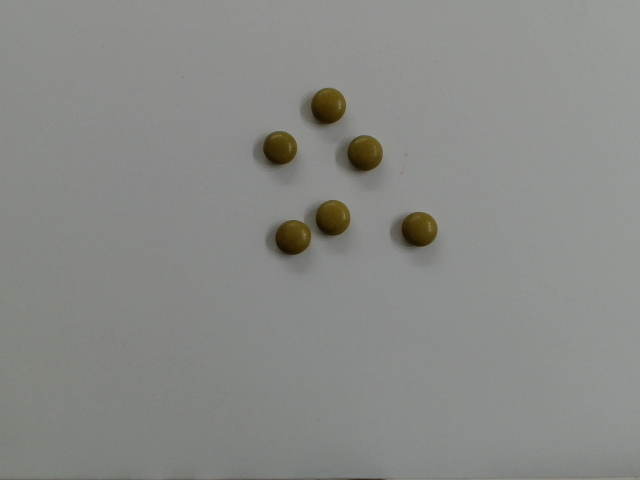


---------------------------------------------------------------------------------------

Green Image

Green - Average Size: 3877.370118242745
Standard Deviation for Green: 286.649955446704


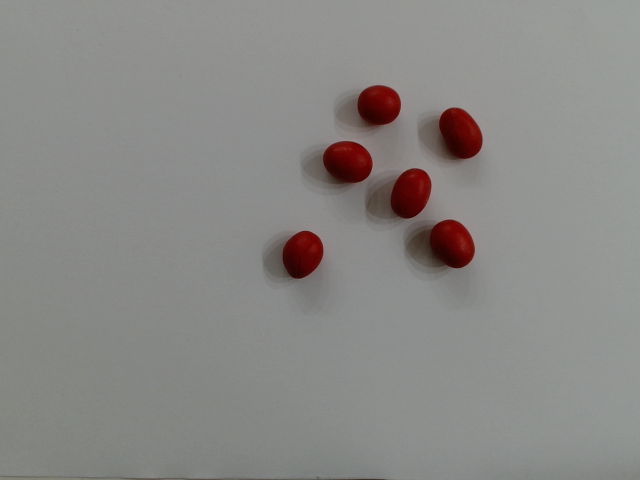


---------------------------------------------------------------------------------------

Blue Image

Blue - Average Size: 2381.8938084821166
Standard Deviation for Blue: 47.41762807119161


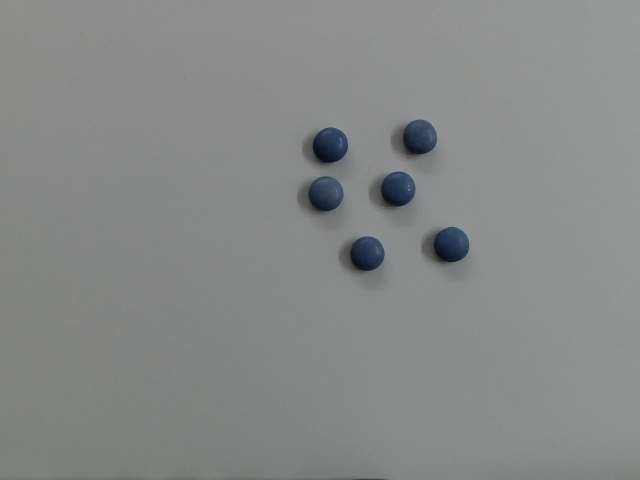


---------------------------------------------------------------------------------------

Brown Nut Image

Brown Nut - Average Size: 4117.9939954091715
Standard Deviation for Brown Nut: 434.0275743121531


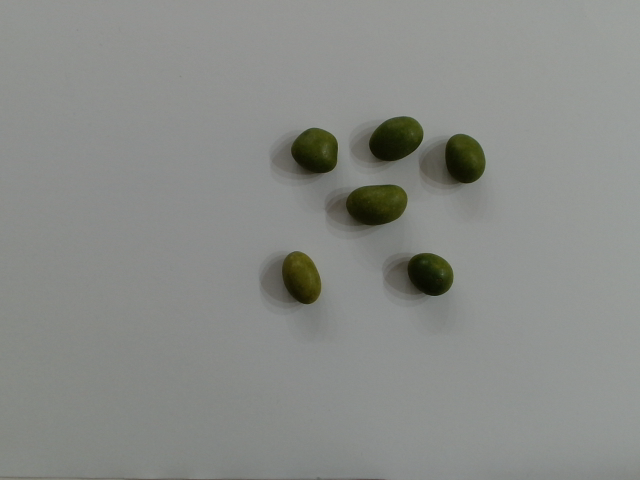


---------------------------------------------------------------------------------------

Yellow Nut Image

Yellow Nut - Average Size: 4858.9068659687755
Standard Deviation for Yellow Nut: 2467.44472609957


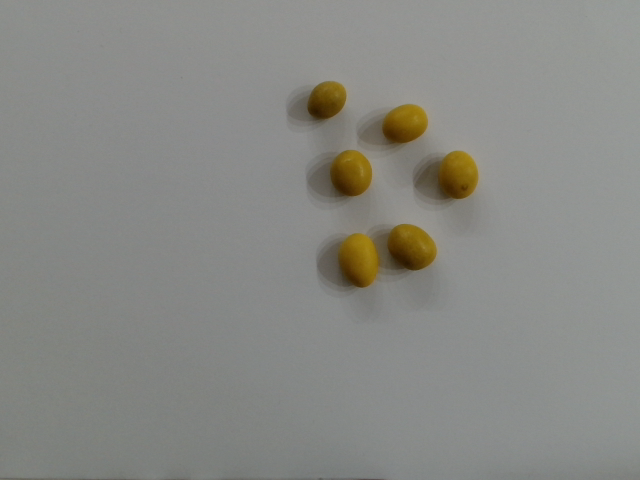


---------------------------------------------------------------------------------------



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow

# Assumindo que data_images_array e image_corrected já estão definidos
sizes=[]
sizes_vector = [[] for _ in range(len(data_images_array))]  # Inicializa um vetor de listas para armazenar os tamanhos
images_desc = ["Red Nut", "Blue Nut", "Yellow", "Brown", "Red", "Green Nut", "Green", "Blue", "Brown Nut", "Yellow Nut"]

# Primeiro loop para processar as imagens e calcular os contornos
for image, image_desc, size_vector in zip(data_images_array, images_desc, sizes_vector):

  print("\n\n")
  image_ori=undistort_image(image)

  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)

  image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)

  v = 255
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], v)

  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

  non_white_pixels = image_gray[image_gray <= 255]

  if non_white_pixels.size > 0:
    sorted_pixels = np.sort(non_white_pixels)
    lowest_100_pixels = sorted_pixels[:10000] if sorted_pixels.size >= 10000 else sorted_pixels
    average_value = np.mean(lowest_100_pixels)

  image_gray = cv2.add(image_gray, np.full(image_gray.shape, (255-average_value)/2, dtype=np.uint8))

  threshold=254
  max_value=255

  background_mask = cv2.threshold(image_gray, threshold, max_value, cv2.THRESH_BINARY)[1]

  object_mask = cv2.bitwise_not(background_mask)

  kernel_3 = np.ones((3, 3), np.uint8)

  object_mask_clean = cv2.erode(object_mask, kernel_3, iterations=1)
  object_mask_clean = cv2.dilate(object_mask_clean, kernel_3, iterations=1)

  contours,_=cv2.findContours(object_mask , cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

  true_contours = 0;

  # Consider only contours with area higher than 20
  for c in contours:
    if (cv2.contourArea(c) < 50):
      continue
    size_vector.append(cv2.contourArea(c))
    #print("Size of the contours:", cv2.contourArea(c))
    true_contours += 1

  #print("Number of Contours found = " + str(true_contours))

#print(sizes_vector)

for image_path, image_desc, size_vector in zip(data_images_array, images_desc, sizes_vector):
  print(image_desc + " Image" + "\n")

  # Carregar a imagem a partir do caminho
  image = cv2.imread(image_path)

  # Calcular e exibir o tamanho médio dos contornos
  average_size = np.sum(size_vector) / len(size_vector) if len(size_vector) > 0 else 0
  print(f"{image_desc} - Average Size: {average_size*Conversion_rate}")

  # Calcular e exibir o desvio padrão
  std_dev = np.std(size_vector) if len(size_vector) > 0 else 0
  print(f"Standard Deviation for {image_desc}: {std_dev*Conversion_rate}")

  # Exibir a imagem
  cv2_imshow(image)
  print("\n---------------------------------------------------------------------------------------\n")



# 4

24.0
203.0


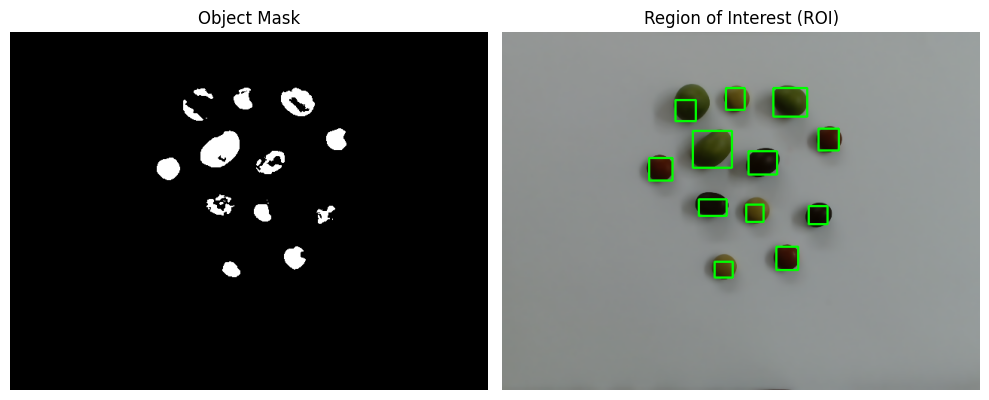

Number of M&Ms: 12
Number of Red: 0
Number of Red Nuts: 0
Number of Blue: 0
Number of Blue Nuts: 0
Number of Brown: 3
Number of Brown Nuts: 3
Number of Green: 2
Number of Green Nuts: 3
Number of Yellow: 0
Number of Yellow Nuts: 0



---------------------------------------------------------------------------------------



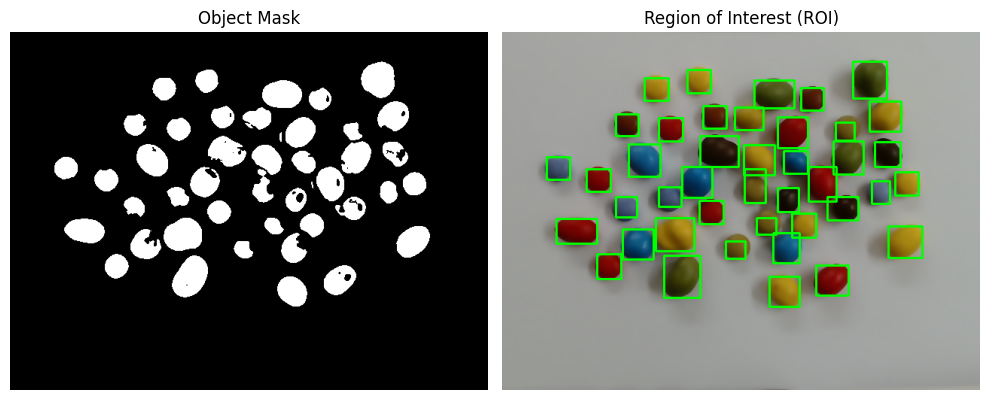

Number of M&Ms: 42
Number of Red: 4
Number of Red Nuts: 4
Number of Blue: 4
Number of Blue Nuts: 5
Number of Brown: 3
Number of Brown Nuts: 4
Number of Green: 4
Number of Green Nuts: 4
Number of Yellow: 5
Number of Yellow Nuts: 5



---------------------------------------------------------------------------------------



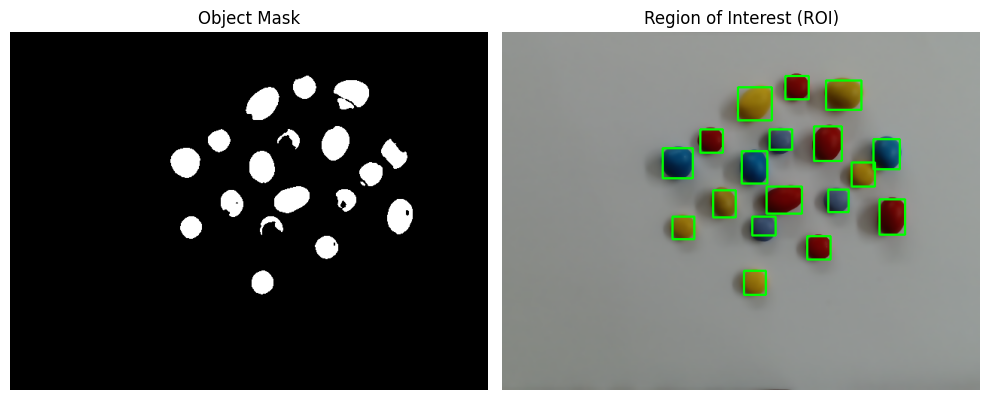

Number of M&Ms: 18
Number of Red: 3
Number of Red Nuts: 3
Number of Blue: 3
Number of Blue Nuts: 3
Number of Brown: 0
Number of Brown Nuts: 0
Number of Green: 0
Number of Green Nuts: 0
Number of Yellow: 4
Number of Yellow Nuts: 2



---------------------------------------------------------------------------------------



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import pandas as pd
from google.colab.patches import cv2_imshow # for image display since cv2.imshow crashes the Colab
from skimage import io
from PIL import Image
import matplotlib.pylab as plt
import time

blue_cnt=0
blue_nut_cnt=0
brown_cnt=0
brown_nut_cnt=0
green_cnt=0
green_nut_cnt=0
red_cnt=0
red_nut_cnt=0
yellow_cnt=0
yellow_nut_cnt=0

def classify_color(median_hsv, area):
    median_h, median_s = median_hsv
    global blue_cnt, blue_nut_cnt, brown_cnt, brown_nut_cnt, green_cnt, green_nut_cnt, red_cnt, red_nut_cnt, yellow_cnt, yellow_nut_cnt

    if (median_h >= 101 and median_h <= 107 and median_s > 147 and median_s < 250):
        blue_nut_cnt += 1
        return "Blue Nut"
    elif (median_h >= 106 and median_h <= 110 and median_s > 61 and median_s < 114):
        blue_cnt += 1
        return "Blue"
    elif (median_h >= 0 and median_h <= 2 and median_s > 217 and median_s < 254):
        if(area > 895):
            red_nut_cnt += 1
            return "Red Nut"
        else:
            red_cnt += 1
        return "Red"
    elif (median_h >= 5 and median_h <= 11 and median_s > 191 and median_s < 243):
        brown_cnt +=1
        return "Brown"
    elif (median_h >= 12 and median_h <= 17 and median_s > 127  and median_s < 255):
        brown_nut_cnt +=1
        return "Brown Nut"
    elif (median_h >= 21 and median_h <= 24 and median_s >= 216  and median_s <= 235):
        if(area > 750):
            yellow_nut_cnt += 1
            return "Yellow Nut"
        else:
            yellow_cnt += 1
        return "Yellow"
    elif (median_h >= 21 and median_h <= 24 and median_s >= 204  and median_s < 216):
        green_cnt += 1
        return "Green"
    elif (median_h >= 25 and median_h <= 35 and median_s > 133  and median_s < 231):
        green_nut_cnt += 1
        return "Green Nut"
    else:
        print(median_h)
        print(median_s)
        return "Unknown"





#RED
light_color_r = (0, 217, 0)
dark_color_r = (2,254, 255)

#BLUE
light_color_b = (101, 147, 0)
dark_color_b = (107,250, 255)

#LBLUE
light_color_lb = (106, 61, 0)
dark_color_lb = (110,114, 255)

#LBrown
light_color_lbrown = (5, 191, 0)
dark_color_lbrown = (11,243, 255)

#DBROWN
light_color_dbrown = (12, 127, 0)
dark_color_dbrown = (17,255, 255)

#YELLOW and LGREEN
light_color_yg = (19, 191, 0)
dark_color_yg = (24,253, 255)

#DGREEN
light_color_dg = (25, 133, 0)
dark_color_dg = (35,231, 255)


for image in data_images_array_mix:
  blue_cnt=0
  blue_nut_cnt=0
  brown_cnt=0
  brown_nut_cnt=0
  green_cnt=0
  green_nut_cnt=0
  red_cnt=0
  red_nut_cnt=0
  yellow_cnt=0
  yellow_nut_cnt=0


  image_ori=undistort_image(image)
  #cv2_imshow(image_ori)
  #print("\n\n")

  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)
  #cv2_imshow(image)
  #print("\n\n")

  image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], 255)

  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

  #cv2_imshow(image_gray)
  #print("\n\n")

  kernel_3 = np.ones((3, 3), np.uint8)
  edges = cv2.Canny(image_gray, 50, 200)
  edges = cv2.dilate(edges, kernel_3, iterations=1)
  #print("edges")
  #cv2_imshow(edges)

  object_mask_r = cv2.inRange(image_hsv, light_color_r, dark_color_r)
  object_mask_b = cv2.inRange(image_hsv, light_color_b, dark_color_b)
  object_mask_lb = cv2.inRange(image_hsv, light_color_lb, dark_color_lb)
  object_mask_lbrown = cv2.inRange(image_hsv, light_color_lbrown, dark_color_lbrown)
  object_mask_dbrown = cv2.inRange(image_hsv, light_color_dbrown, dark_color_dbrown)
  object_mask_yg = cv2.inRange(image_hsv, light_color_yg, dark_color_yg)
  object_mask_dg = cv2.inRange(image_hsv, light_color_dg, dark_color_dg)

  kernel_3 = np.ones((3, 3), np.uint8)

  object_mask_r_clean = cv2.medianBlur(object_mask_r, 3)
  object_mask_r_clean = cv2.erode(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_r_clean = cv2.dilate(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.medianBlur(object_mask_b, 3)
  object_mask_b_clean = cv2.erode(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.dilate(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.medianBlur(object_mask_lb, 3)
  object_mask_lb_clean = cv2.erode(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.dilate(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.medianBlur(object_mask_lbrown, 3)
  object_mask_lbrown_clean = cv2.erode(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.dilate(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.medianBlur(object_mask_dbrown, 3)
  object_mask_dbrown_clean = cv2.erode(object_mask_dbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.dilate(object_mask_dbrown_clean, kernel_3, iterations=1)

  object_mask  = cv2.bitwise_or(object_mask_r, object_mask_b)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lb)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lbrown)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dbrown)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_yg)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dg)


  #cv2_imshow(object_mask)
  #print("image_gray_filtered")
  mask_inversed = cv2.bitwise_not(object_mask)
  object_mask = cv2.subtract(object_mask ,edges)
  object_mask = cv2.medianBlur(object_mask, 3)
  #cv2_imshow(object_mask)
  #print("\n\n")

  non_white_pixels = image_gray[image_gray <= 255]

  kernel_3 = np.ones((5, 5), np.uint8)

  object_mask_clean = object_mask

  contours,_=cv2.findContours(object_mask , cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  true_contours = 0;

  # Consider only contours with area higher than 20
  for c in contours:
    if (cv2.contourArea(c) < 200):
      continue
    mask = np.zeros(image_hsv.shape[:2], dtype=np.uint8)
    cv2.drawContours(mask, [c], -1, 255, thickness=cv2.FILLED)

    h_channel = image_hsv[:, :, 0][mask == 255]  # Extract hue channel where mask is white
    s_channel = image_hsv[:, :, 1][mask == 255]  # Extract saturation channel where mask is white

    # Compute the median for each channel
    median_h = np.median(h_channel)
    median_s = np.median(s_channel)

    # Combine the medians into a tuple
    median_hsv = (median_h, median_s)

    # Classify the color based on the median HSV values
    color_class = classify_color(median_hsv, cv2.contourArea(c))

    #print("Color Class: " + color_class)
    #cv2_imshow(mask)
    #print("\n\n")
    x,y,w,h = cv2.boundingRect(c)
    ROI=cv2.rectangle(image,(x,y),(x+w,y+h),(0,255,0),2)
    true_contours += 1

  #show image with centroid
  fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

  # Display the first image
  axes[0].imshow(object_mask_clean, cmap='gray')
  axes[0].set_title("Object Mask")
  axes[0].axis('off')  # Turn off axis

  # Display the second image
  ROI = cv2.cvtColor(ROI, cv2.COLOR_BGR2RGB)
  axes[1].imshow(ROI)
  axes[1].set_title("Region of Interest (ROI)")
  axes[1].axis('off')  # Turn off axis

  # Show the plot
  #plt.suptitle("White Isolated " + str(image_desc) + " Mask and ROI, " + str(true_contours) + " M&M's identified", fontsize=16)
  plt.tight_layout()
  plt.show()
  print("Number of M&Ms: " + str(true_contours))
  print("Number of Red: " + str(red_cnt))
  print("Number of Red Nuts: " + str(red_nut_cnt))
  print("Number of Blue: " + str(blue_cnt))
  print("Number of Blue Nuts: " + str(blue_nut_cnt))
  print("Number of Brown: " + str(brown_cnt))
  print("Number of Brown Nuts: " + str(brown_nut_cnt))
  print("Number of Green: " + str(green_cnt))
  print("Number of Green Nuts: " + str(green_nut_cnt))
  print("Number of Yellow: " + str(yellow_cnt))
  print("Number of Yellow Nuts: " + str(yellow_nut_cnt))
  print("\n\n")
  print("---------------------------------------------------------------------------------------\n")

# 5

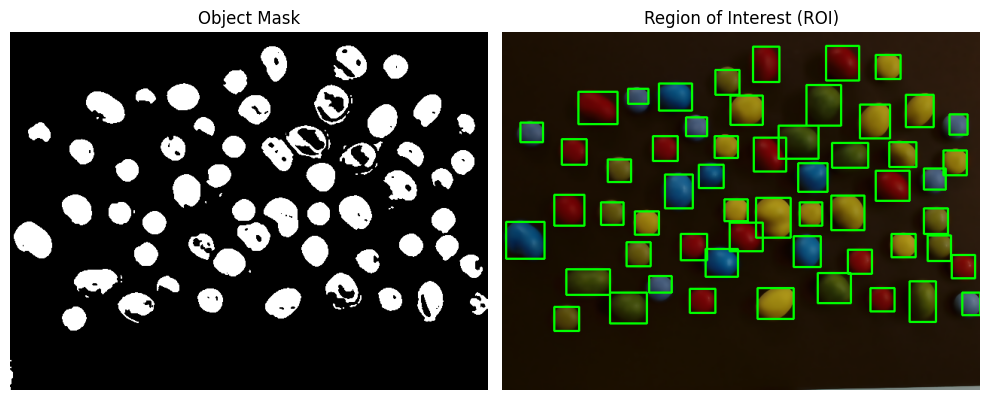

Number of M&Ms: 56
Number of Red: 7
Number of Red Nuts: 7
Number of Blue: 7
Number of Blue Nuts: 7
Number of Brown: 0
Number of Brown Nuts: 0
Number of Green: 8
Number of Green Nuts: 6
Number of Yellow: 7
Number of Yellow Nuts: 7



---------------------------------------------------------------------------------------



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import pandas as pd
from google.colab.patches import cv2_imshow # for image display since cv2.imshow crashes the Colab
from skimage import io
from PIL import Image
import matplotlib.pylab as plt
import time

blue_cnt=0
blue_nut_cnt=0
brown_cnt=0
brown_nut_cnt=0
green_cnt=0
green_nut_cnt=0
red_cnt=0
red_nut_cnt=0
yellow_cnt=0
yellow_nut_cnt=0

def classify_color(median_hsv, area):
    median_h, median_s = median_hsv
    global blue_cnt, blue_nut_cnt, brown_cnt, brown_nut_cnt, green_cnt, green_nut_cnt, red_cnt, red_nut_cnt, yellow_cnt, yellow_nut_cnt

    if (median_h >= 101 and median_h <= 107 and median_s > 147 and median_s < 250):
        blue_nut_cnt += 1
        return "Blue Nut"
    elif (median_h >= 106 and median_h <= 110 and median_s > 61 and median_s < 114):
        blue_cnt += 1
        return "Blue"
    elif (median_h >= 0 and median_h <= 2 and median_s > 217 and median_s < 254):
        if(area > 895):
            red_nut_cnt += 1
            return "Red Nut"
        else:
            red_cnt += 1
        return "Red"
    elif (median_h >= 5 and median_h <= 11 and median_s > 191 and median_s < 243):
        brown_cnt +=1
        return "Brown"
    elif (median_h >= 12 and median_h <= 17 and median_s > 127  and median_s < 255):
        brown_nut_cnt +=1
        return "Brown Nut"
    elif (median_h >= 21 and median_h <= 24 and median_s >= 215  and median_s <= 235):
        if(area > 725):
            yellow_nut_cnt += 1
            return "Yellow Nut"
        else:
            yellow_cnt += 1
        return "Yellow"
    elif (median_h >= 24 and median_h <= 30 and median_s >= 203  and median_s <= 227):
        green_cnt += 1
        return "Green"
    elif (median_h >= 30 and median_h <= 37 and median_s >= 203  and median_s <= 227):
        green_nut_cnt += 1
        return "Green Nut"
    else:
        print("UK")
        print(median_h)
        print(median_s)
        print("\n")
        return "Unknown"


#RED
light_color_r = (0, 217, 0)
dark_color_r = (2,254, 255)

#BLUE
light_color_b = (101, 147, 0)
dark_color_b = (107,250, 255)

#LBLUE
light_color_lb = (106, 61, 0)
dark_color_lb = (110,114, 255)

#LBrown
light_color_lbrown = (5, 191, 0)
dark_color_lbrown = (11,243, 255)

#DBROWN
light_color_dbrown = (12, 127, 0)
dark_color_dbrown = (17,255, 255)

#YELLOW and LGREEN
light_color_yg = (19, 191, 0)
dark_color_yg = (24,253, 255)

#DGREEN
light_color_dg = (25, 133, 0)
dark_color_dg = (35,231, 255)

dark_blue_cnt=0
light_blue_cnt=0
red_cnt=0
light_brown_cnt=0
dark_brown_cnt=0
yellow_cnt=0
light_green_cnt=0
dark_green_cnt=0


for image in data_images_array_brown:
  image_ori=undistort_image(image)
  #cv2_imshow(
  #cv2_imshow(image_ori)
  #print("\n\n")

  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)
  #cv2_imshow(image)
  #print("\n\n")

  image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], 255)

  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
  #image_gray = cv2.add(image_gray, np.full(image_gray.shape, 10, dtype=np.uint8))
  #cv2_imshow(image_gray)
  #print("\n\n")

  kernel_3 = np.ones((3, 3), np.uint8)
  edges = cv2.Canny(image_gray, 50, 200)
  edges = cv2.dilate(edges, kernel_3, iterations=1)
  #print("edges")
  #cv2_imshow(edges)

  object_mask_r = cv2.inRange(image_hsv, light_color_r, dark_color_r)
  object_mask_b = cv2.inRange(image_hsv, light_color_b, dark_color_b)
  object_mask_lb = cv2.inRange(image_hsv, light_color_lb, dark_color_lb)
  object_mask_lbrown = cv2.inRange(image_hsv, light_color_lbrown, dark_color_lbrown)
  object_mask_dbrown = cv2.inRange(image_hsv, light_color_dbrown, dark_color_dbrown)
  object_mask_yg = cv2.inRange(image_hsv, light_color_yg, dark_color_yg)
  object_mask_dg = cv2.inRange(image_hsv, light_color_dg, dark_color_dg)

  kernel_3 = np.ones((3, 3), np.uint8)

  object_mask_r_clean = cv2.medianBlur(object_mask_r, 3)
  object_mask_r_clean = cv2.erode(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_r_clean = cv2.dilate(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.medianBlur(object_mask_b, 3)
  object_mask_b_clean = cv2.erode(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.dilate(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.medianBlur(object_mask_lb, 3)
  object_mask_lb_clean = cv2.erode(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.dilate(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.medianBlur(object_mask_lbrown, 3)
  object_mask_lbrown_clean = cv2.erode(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.dilate(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.medianBlur(object_mask_dbrown, 3)
  object_mask_dbrown_clean = cv2.erode(object_mask_dbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.dilate(object_mask_dbrown_clean, kernel_3, iterations=1)

  object_mask  = cv2.bitwise_or(object_mask_r, object_mask_b)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lb)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_yg)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dg)


  #cv2_imshow(object_mask)
  #print("image_gray_filtered")
  mask_inversed = cv2.bitwise_not(object_mask)
  object_mask = cv2.subtract(object_mask ,edges)
  object_mask = cv2.medianBlur(object_mask, 3)
  #cv2_imshow(object_mask)
  #print("\n\n")

  non_white_pixels = image_gray[image_gray <= 255]

  kernel_3 = np.ones((5, 5), np.uint8)

  object_mask_clean = object_mask

  contours,_=cv2.findContours(object_mask , cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  true_contours = 0;

  # Consider only contours with area higher than 20
  for c in contours:
    if (cv2.contourArea(c) < 200):
      continue
    mask = np.zeros(image_hsv.shape[:2], dtype=np.uint8)
    cv2.drawContours(mask, [c], -1, 255, thickness=cv2.FILLED)

    h_channel = image_hsv[:, :, 0][mask == 255]  # Extract hue channel where mask is white
    s_channel = image_hsv[:, :, 1][mask == 255]  # Extract saturation channel where mask is white

    # Compute the median for each channel
    median_h = np.median(h_channel)
    median_s = np.median(s_channel)

    # Combine the medians into a tuple
    median_hsv = (median_h, median_s)

    # Classify the color based on the median HSV values
    color_class = classify_color(median_hsv, cv2.contourArea(c))

    #print("Color Class: " + color_class)
    #cv2_imshow(mask)
    #print("\n\n")
    x,y,w,h = cv2.boundingRect(c)
    ROI=cv2.rectangle(image,(x,y),(x+w,y+h),(0,255,0),2)
    true_contours += 1

  #show image with centroid
  fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

  # Display the first image
  axes[0].imshow(object_mask_clean, cmap='gray')
  axes[0].set_title("Object Mask")
  axes[0].axis('off')  # Turn off axis

  # Display the second image
  ROI = cv2.cvtColor(ROI, cv2.COLOR_BGR2RGB)
  axes[1].imshow(ROI)
  axes[1].set_title("Region of Interest (ROI)")
  axes[1].axis('off')  # Turn off axis

  # Show the plot
  #plt.suptitle("White Isolated " + str(image_desc) + " Mask and ROI, " + str(true_contours) + " M&M's identified", fontsize=16)
  plt.tight_layout()
  plt.show()
  print("Number of M&Ms: " + str(true_contours))
  print("Number of Red: " + str(red_cnt))
  print("Number of Red Nuts: " + str(red_nut_cnt))
  print("Number of Blue: " + str(blue_cnt))
  print("Number of Blue Nuts: " + str(blue_nut_cnt))
  print("Number of Brown: " + str(brown_cnt))
  print("Number of Brown Nuts: " + str(brown_nut_cnt))
  print("Number of Green: " + str(green_cnt))
  print("Number of Green Nuts: " + str(green_nut_cnt))
  print("Number of Yellow: " + str(yellow_cnt))
  print("Number of Yellow Nuts: " + str(yellow_nut_cnt))
  print("\n\n")
  print("---------------------------------------------------------------------------------------\n")